<a href="https://colab.research.google.com/github/alisharifi2000/Genetic_TSP/blob/main/Genetic_TSP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install opencage
!apt-get install libgeos-3.5.0
!apt-get install libgeos-dev
!pip install https://github.com/matplotlib/basemap/archive/master.zip
!pip install pyproj==1.9.6

     |████████████████████████████████| 61kB 6.4MB/s 
     |████████████████████████████████| 2.6MB 30.2MB/s 
Reading package lists... Done
Building dependency tree       
Reading state information... Done
E: Unable to locate package libgeos-3.5.0
E: Couldn't find any package by glob 'libgeos-3.5.0'
E: Couldn't find any package by regex 'libgeos-3.5.0'
Reading package lists... Done
Building dependency tree       
Reading state information... Done
Suggested packages:
  libgdal-doc
The following NEW packages will be installed:
  libgeos-dev
0 upgraded, 1 newly installed, 0 to remove and 15 not upgraded.
Need to get 73.1 kB of archives.
After this operation, 486 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libgeos-dev amd64 3.6.2-1build2 [73.1 kB]
Fetched 73.1 kB in 1s (103 kB/s)
Selecting previously unselected package libgeos-dev.
(Reading database ... 145480 files and directories currently installed.)
Preparing to unpack .../libg

     |████████████████████████████████| 2.8MB 7.8MB/s 
  Created wheel for pyproj: filename=pyproj-1.9.6-cp36-cp36m-linux_x86_64.whl size=3702126 sha256=4d9125421283cb0e7d551d631a8a0e62d0d870c5cf496271b0d5bd6ab633b922
  Stored in directory: /root/.cache/pip/wheels/02/cd/b1/a2d6430f74c7a778a43d62f78bec109ca69c732dc9b929142a
Successfully built pyproj
  Found existing installation: pyproj 3.0.0.post1
    Uninstalling pyproj-3.0.0.post1:
      Successfully uninstalled pyproj-3.0.0.post1


In [2]:
import requests
import json
from sys import maxsize
from opencage.geocoder import OpenCageGeocode
from geopy import distance
import pandas as pd
import random
from random import random, randint, sample
from time import time
import operator
from numpy import vectorize
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
from itertools import chain
import random
from datetime import datetime
import matplotlib.pyplot as plt
from random import sample

%matplotlib inline

In [3]:
def draw_map(m, scale=0.2):
    # draw a shaded-relief image
    m.shadedrelief(scale=scale)
    
    # lats and longs are returned as a dictionary
    lats = m.drawparallels(np.linspace(-90, 90, 13))
    lons = m.drawmeridians(np.linspace(-180, 180, 13))

    # keys contain the plt.Line2D instances
    lat_lines = chain(*(tup[1][0] for tup in lats.items()))
    lon_lines = chain(*(tup[1][0] for tup in lons.items()))
    all_lines = chain(lat_lines, lon_lines)
    
    # cycle through these lines and set the desired style
    for line in all_lines:
        line.set(linestyle='-', alpha=0.3, color='w')

In [4]:
def get_location(city,country):
    key = '94bbd66c2b5743b4b4acf04d59f6559c'
    geocoder = OpenCageGeocode(key)
    query = city+' , '+country  
    results = geocoder.geocode(query)
    lat = results[0]['geometry']['lat']
    lng = results[0]['geometry']['lng']
    
    return [lat,lng]

In [5]:
def get_city_country(cities):
  city = [c.split(',')[0] for c in cities.split('\n')]
  print(city)
  country = [c.split(',')[1] for c in cities.split('\n')]
  print(country)

  return [city,country]

In [6]:
def make_dataset(city,country):
  # make dataframe 
  dict = {'City':city,'Country':country}
  dataset = pd.DataFrame(dict)
  dataset['lat'] = 0
  dataset['lng'] = 0
  dataset.index = dataset['City']

  return dataset

In [7]:
def fill_lat_lng(dataset):
  for c in list(dataset.index):
      city_name = dataset.loc[c,'City']
      country_name = dataset.loc[c,'Country']
      [lat,lng] = get_location(city_name,country_name)
      dataset.loc[c,'lat'] = lat
      dataset.loc[c,'lng'] = lng
    
  return dataset

In [8]:
def draw_cities_in_map(dataset):
  fig = plt.figure(figsize=(15, 10), edgecolor='w')
  m = Basemap(projection='cyl', resolution=None,
            llcrnrlat=-90, urcrnrlat=90,
            llcrnrlon=-180, urcrnrlon=180, )
  m.scatter(dataset['lng'], dataset['lat'], latlon=True,
          c = 'black', s = 5)
  draw_map(m)

# Genetic Algorithm

In [9]:
class Gene:  # City
    # keep distances from cities saved in a table to improve execution time.
    __distances_table = {}

    def __init__(self, name, lat, lng):
        self.name = name
        self.lat = lat
        self.lng = lng

    def get_distance_to(self, dest):
        origin = (self.lat, self.lng)
        dest = (dest.lat, dest.lng)

        forward_key = origin + dest
        backward_key = dest + origin

        if forward_key in Gene.__distances_table:
            return Gene.__distances_table[forward_key]

        if backward_key in Gene.__distances_table:
            return Gene.__distances_table[backward_key]

        dist = int(distance.distance(origin, dest).km)
        Gene.__distances_table[forward_key] = dist

        return dist

In [10]:
class Individual:  # Route: possible solution to TSP
    def __init__(self, genes):
        assert(len(genes) > 3)
        self.genes = genes
        self.__reset_params()

    def swap(self, gene_1, gene_2):
        self.genes[0]
        a, b = self.genes.index(gene_1), self.genes.index(gene_2)
        self.genes[b], self.genes[a] = self.genes[a], self.genes[b]
        self.__reset_params()

    def add(self, gene):
        self.genes.append(gene)
        self.__reset_params()

    @property
    def fitness(self):
        if self.__fitness == 0:
            self.__fitness = 1 / self.travel_cost  # Normalize travel cost
        return self.__fitness

    @property
    def travel_cost(self):  # Get total travelling cost
        if self.__travel_cost == 0:
            for i in range(len(self.genes)):
                origin = self.genes[i]
                if i == len(self.genes) - 1:
                    dest = self.genes[0]
                else:
                    dest = self.genes[i+1]

                self.__travel_cost += origin.get_distance_to(dest)

        return self.__travel_cost

    def __reset_params(self):
        self.__travel_cost = 0
        self.__fitness = 0

In [11]:
class Population:  # Population of individuals
    def __init__(self, individuals):
        self.individuals = individuals

    @staticmethod
    def gen_individuals(sz, genes):
        individuals = []
        for _ in range(sz):
            individuals.append(Individual(sample(genes, len(genes))))
        return Population(individuals)

    def add(self, route):
        self.individuals.append(route)

    def rmv(self, route):
        self.individuals.remove(route)

    def get_fittest(self):
        fittest = self.individuals[0]
        for route in self.individuals:
            if route.fitness > fittest.fitness:
                fittest = route

        return fittest

In [12]:
def evolve(pop, tourn_size, mut_rate):
    new_generation = Population([])
    pop_size = len(pop.individuals)
    elitism_num = pop_size // 2

    # Elitism
    for _ in range(elitism_num):
        fittest = pop.get_fittest()
        new_generation.add(fittest)
        pop.rmv(fittest)

    # Crossover
    for _ in range(elitism_num, pop_size):
        parent_1 = selection(new_generation, tourn_size)
        parent_2 = selection(new_generation, tourn_size)
        child = crossover(parent_1, parent_2)
        new_generation.add(child)

    # Mutation
    for i in range(elitism_num, pop_size):
        mutate(new_generation.individuals[i], mut_rate)

    return new_generation

In [13]:

def crossover(parent_1, parent_2):
    def fill_with_parent1_genes(child, parent, genes_n):
        start_at = randint(0, len(parent.genes)-genes_n-1)
        finish_at = start_at + genes_n
        for i in range(start_at, finish_at):
            child.genes[i] = parent_1.genes[i]

    def fill_with_parent2_genes(child, parent):
        j = 0
        for i in range(0, len(parent.genes)):
            if child.genes[i] == None:
                while parent.genes[j] in child.genes:
                    j += 1
                child.genes[i] = parent.genes[j]
                j += 1

    genes_n = len(parent_1.genes)
    child = Individual([None for _ in range(genes_n)])
    fill_with_parent1_genes(child, parent_1, genes_n // 2)
    fill_with_parent2_genes(child, parent_2)

    return child

In [14]:
def mutate(individual, rate):
    for _ in range(len(individual.genes)):
        if random.random() < rate:
            sel_genes = sample(individual.genes, 2)
            individual.swap(sel_genes[0], sel_genes[1])

In [15]:
def selection(population, competitors_n):
    return Population(sample(population.individuals, competitors_n)).get_fittest()

In [16]:
def run_ga(genes, pop_size, n_gen, tourn_size, mut_rate, verbose):
    population = Population.gen_individuals(pop_size, genes)
    history = {'cost': [population.get_fittest().travel_cost]}
    counter, generations, min_cost = 0, 0, maxsize

    if verbose == 1:
        print("-- TSP-GA -- Initiating evolution...")

    start_time = time()
    while counter < n_gen:
        population = evolve(population, tourn_size, mut_rate)
        cost = population.get_fittest().travel_cost

        if cost < min_cost:
            counter, min_cost = 0, cost
        else:
            counter += 1

        generations += 1
        history['cost'].append(cost)

    total_time = round(time() - start_time, 6)

    if verbose == 1:
        print("-- TSP-GA -- Evolution finished after {} generations in {} s".format(generations, total_time))
        print("-- TSP-GA -- Minimum travelling cost {} KM".format(min_cost))

    history['generations'] = generations
    history['total_time'] = total_time
    history['route'] = population.get_fittest()

    return history

In [17]:
def get_genes_from(dataset, sample_n=0):
    genes = [Gene(row['City'], row['lat'], row['lng'])
             for _, row in dataset.iterrows()]

    return genes if sample_n <= 0 else sample(genes, sample_n)

In [18]:
def plot_ga_convergence(costs):
    x = range(len(costs))
    plt.figure(figsize=(10, 5), edgecolor='w')
    plt.title("GA Convergence")
    plt.xlabel('generation')
    plt.ylabel('cost (KM)')
    plt.text(x[len(x) // 2], costs[0], 'min cost: {} KM'.format(costs[-1]), ha='center', va='center')
    plt.plot(x, costs, '-')

In [19]:
def plot_route(individual):
    plt.figure(figsize=(15, 10), edgecolor='w')
    plt.title("Best Route (start point is blue )")
    m = Basemap(projection='cyl', resolution=None,
            llcrnrlat=-90, urcrnrlat=90,
            llcrnrlon=-180, urcrnrlon=180, )
    
    lat = []
    lon = []

    for i in range(len(individual.genes)):
      lat.append(individual.genes[i].lat)
      lon.append(individual.genes[i].lng)

    x, y = m(lon, lat)

    
    m.plot(x, y, '--', markersize=4, linewidth=1 , c = 'red')

    m.scatter(x, y, latlon=True,
          c = 'black', s = 8)
    
    m.scatter(lon[0], lat[0], latlon=True,
          c = 'blue', s = 15 , marker = 'x')
    
    draw_map(m)

In [20]:
def show_best_path(individual):
    print('-----------------')
    print('Best Path : ')
    print('-----------------')
    for i in range(len(individual.genes)):
      print('{} . {}'.format(i+1,individual.genes[i].name))

In [21]:
def run(verbose,pop_size = 500 ,tourn_size = 50 ,mut_rate = 0.02 , n_gen = 20 , dataset = None):
  '''
  verbose - > show results 
  pop_size - > Population
  tourn_size - > Tournament size'
  mut_rate - > Mutation rate
  n_gen - > Number of equal generations before stopping
  dataset - > dataset of cities
  '''
  genes = get_genes_from(dataset)

  if verbose == 1:
      print("-- Running TSP-GA with {} cities --".format(len(genes)))
      history = run_ga(genes, pop_size, n_gen,
                        tourn_size, mut_rate, verbose = 1)
      print("-- Done --")
      return history
  
  elif verbose == 0:
      #print("-- Running TSP-GA with {} cities --".format(len(genes)))
      history = run_ga(genes, pop_size, n_gen,
                        tourn_size, mut_rate, verbose = 0)
      #print("-- Done --")
      return history

# 10 Cities

In [ ]:
# 10 cities
cities = """New York,USA
Los Angeles,USA
Chicago,USA
London,UK
Paris,France
Tehran,Iran
Istanbul,Turkey
San Francisco,USA
Washington DC,USA
Boston,USA"""

In [ ]:
result = get_city_country(cities)
dataset = make_dataset(result[0],result[1])
dataset = fill_lat_lng(dataset)
dataset.head()

['New York', 'Los Angeles', 'Chicago', 'London', 'Paris', 'Tehran', 'Istanbul', 'San Francisco', 'Washington DC', 'Boston']
['USA', 'USA', 'USA', 'UK', 'France', 'Iran', 'Turkey', 'USA', 'USA', 'USA']


,City,Country,lat,lng
City,,,,
New York,New York,USA,40.712728,-74.006015
Los Angeles,Los Angeles,USA,34.053691,-118.242766
Chicago,Chicago,USA,41.875562,-87.624421
London,London,UK,51.507322,-0.127647
Paris,Paris,France,48.856697,2.351462


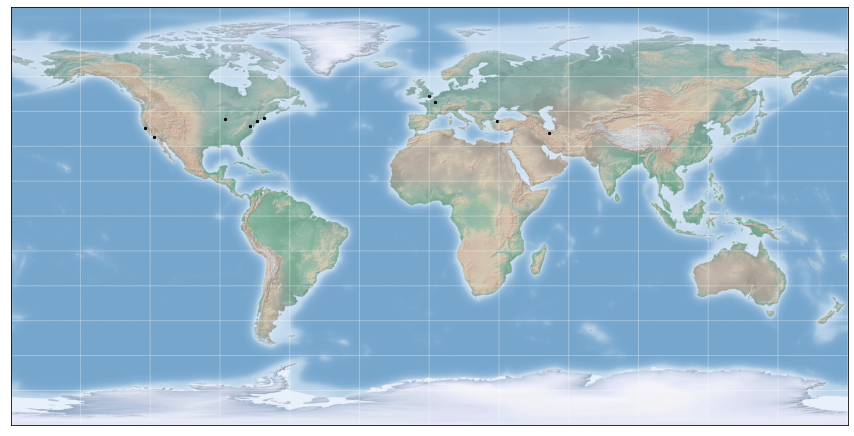

In [ ]:
draw_cities_in_map(dataset)

## defult parameters

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 22 generations in 1.853029 s
-- TSP-GA -- Minimum travelling cost 27815 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Los Angeles
2 . Chicago
3 . Washington DC
4 . New York
5 . Boston
6 . London
7 . Paris
8 . Istanbul
9 . Tehran
10 . San Francisco


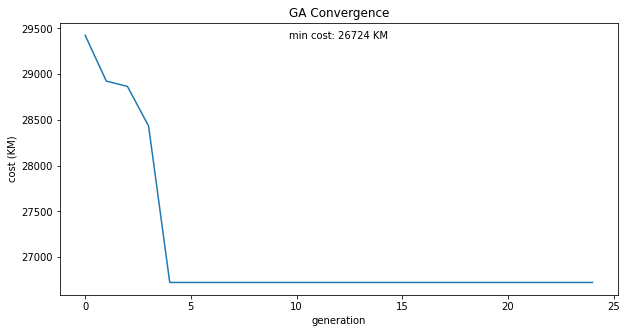

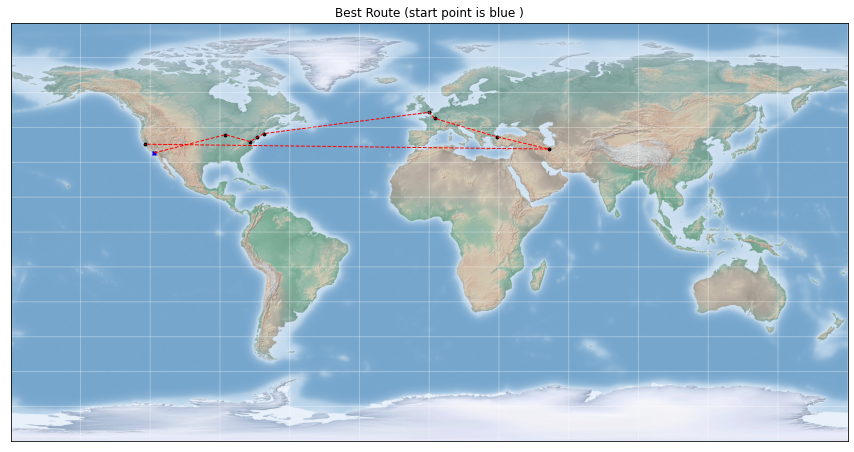

In [ ]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 100

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 29 generations in 0.249231 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Boston
2 . London
3 . Paris
4 . Istanbul
5 . Tehran
6 . San Francisco
7 . Los Angeles
8 . Chicago
9 . Washington DC
10 . New York


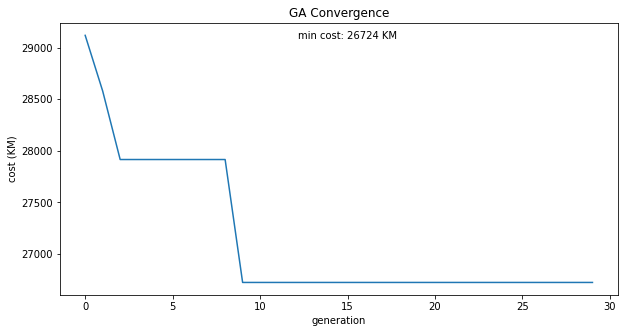

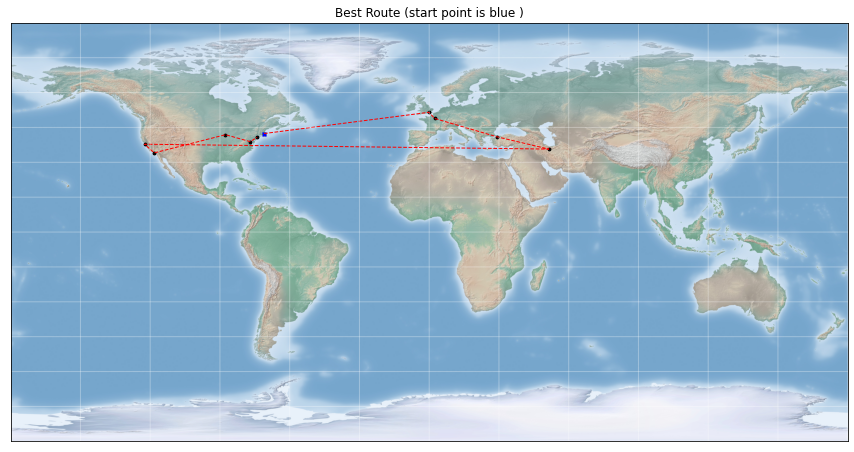

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 0
pop_size = 500 - > 100
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 100 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history =  run(verbose = 0 ,pop_size = 100 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 200

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 29 generations in 0.548455 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Paris
2 . Istanbul
3 . Tehran
4 . San Francisco
5 . Los Angeles
6 . Chicago
7 . Washington DC
8 . New York
9 . Boston
10 . London


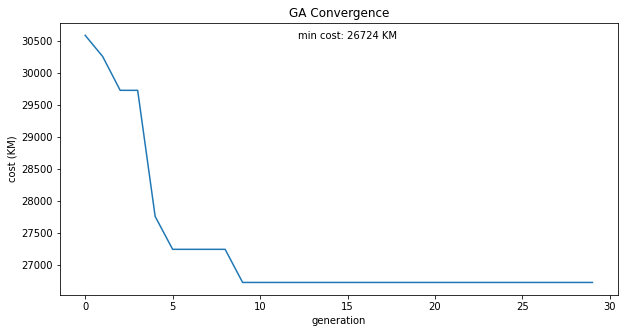

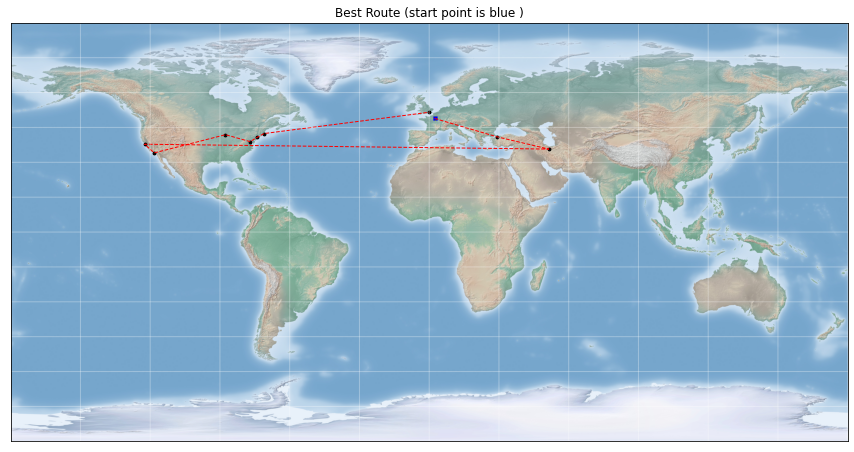

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 0
pop_size = 500 - > 200
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 200 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history =  run(verbose = 0 ,pop_size = 200 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 750

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 21 generations in 2.720435 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Istanbul
2 . Tehran
3 . San Francisco
4 . Los Angeles
5 . Chicago
6 . Washington DC
7 . New York
8 . Boston
9 . London
10 . Paris


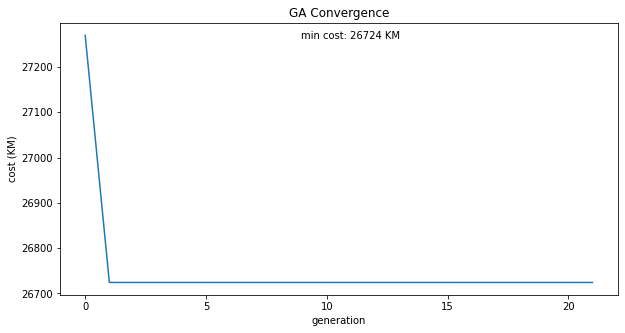

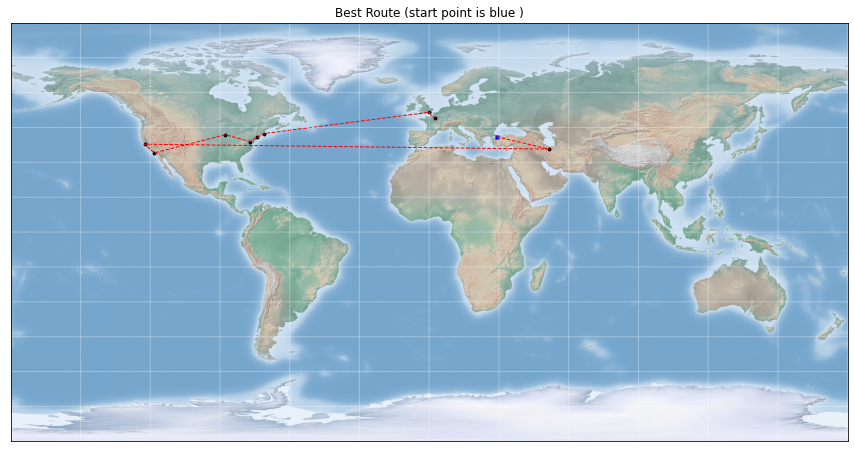

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 0
pop_size = 500 - > 750 
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 750 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,pop_size = 750 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 1000

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 22 generations in 4.700474 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . San Francisco
2 . Tehran
3 . Istanbul
4 . Paris
5 . London
6 . Boston
7 . New York
8 . Washington DC
9 . Chicago
10 . Los Angeles


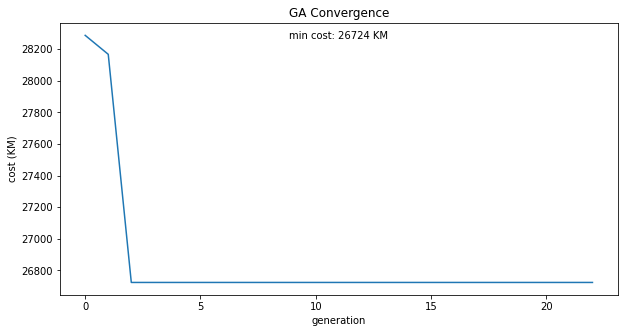

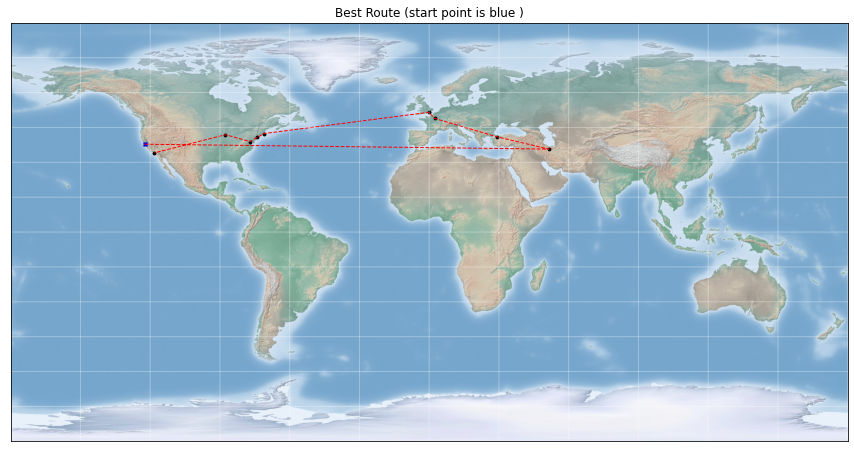

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 0
pop_size = 500 - > 1000
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 1000 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,pop_size = 1000 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 2000

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 21 generations in 14.195211 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Washington DC
2 . Chicago
3 . Los Angeles
4 . San Francisco
5 . Tehran
6 . Istanbul
7 . Paris
8 . London
9 . Boston
10 . New York


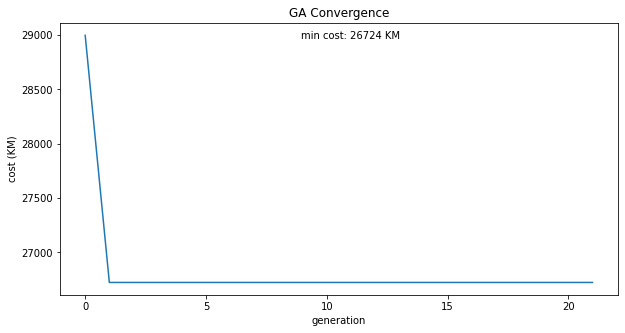

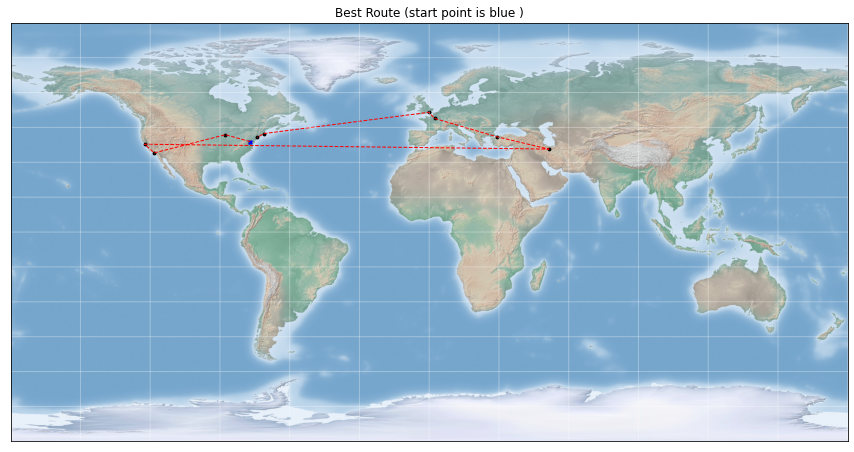

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 0
pop_size = 500 - > 2000
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 2000 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,pop_size = 2000 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 1

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 40 generations in 1.813058 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Tehran
2 . Istanbul
3 . Paris
4 . London
5 . Boston
6 . New York
7 . Washington DC
8 . Chicago
9 . Los Angeles
10 . San Francisco


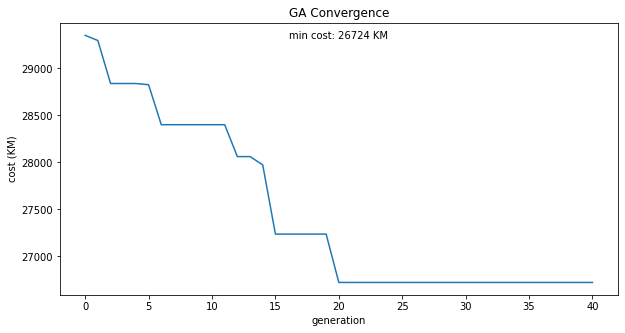

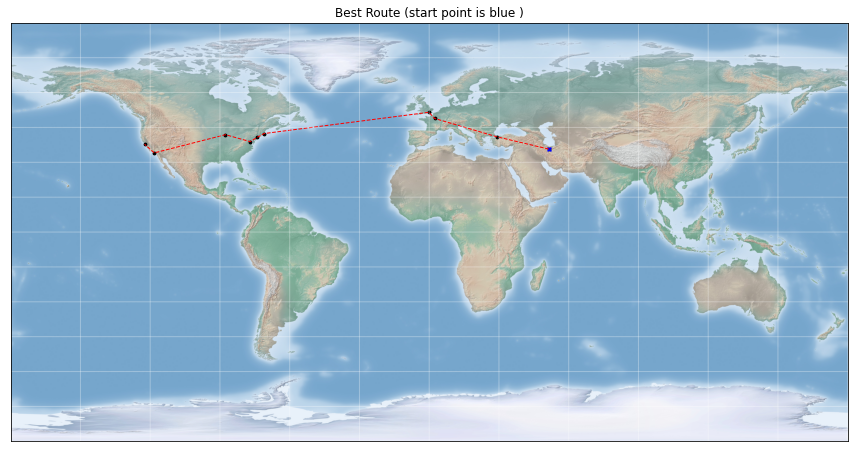

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 - > 1
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 , tourn_size = 1 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 1 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 10

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 34 generations in 1.709506 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Washington DC
2 . New York
3 . Boston
4 . London
5 . Paris
6 . Istanbul
7 . Tehran
8 . San Francisco
9 . Los Angeles
10 . Chicago


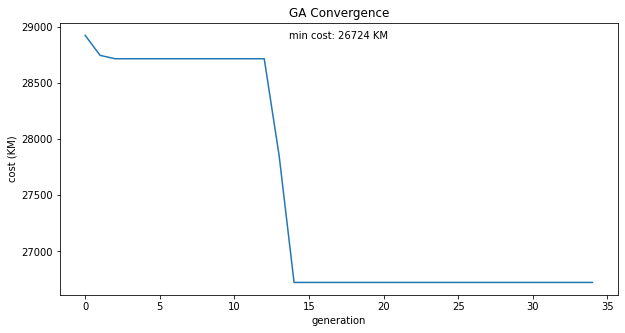

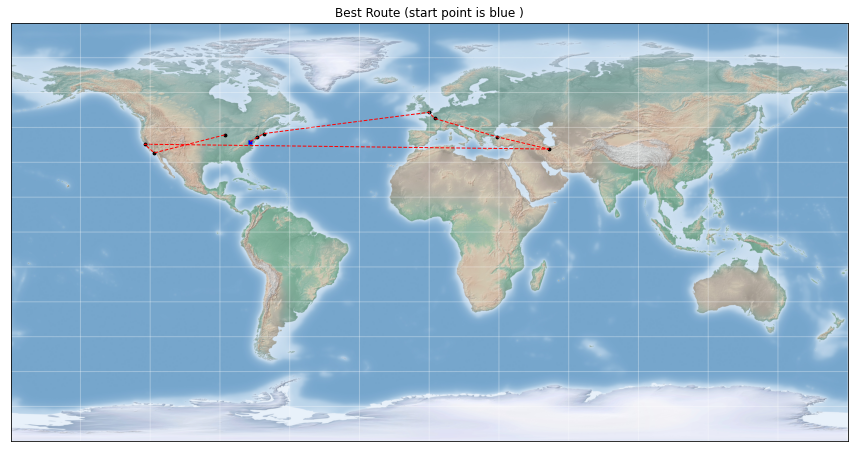

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 - > 10
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 , tourn_size = 10 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 10 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 25

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 22 generations in 1.24963 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Washington DC
2 . Chicago
3 . Los Angeles
4 . San Francisco
5 . Tehran
6 . Istanbul
7 . Paris
8 . London
9 . Boston
10 . New York


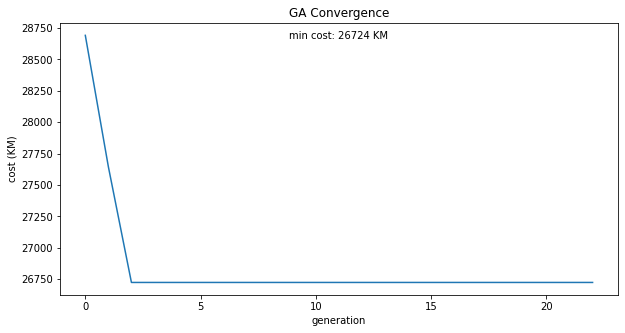

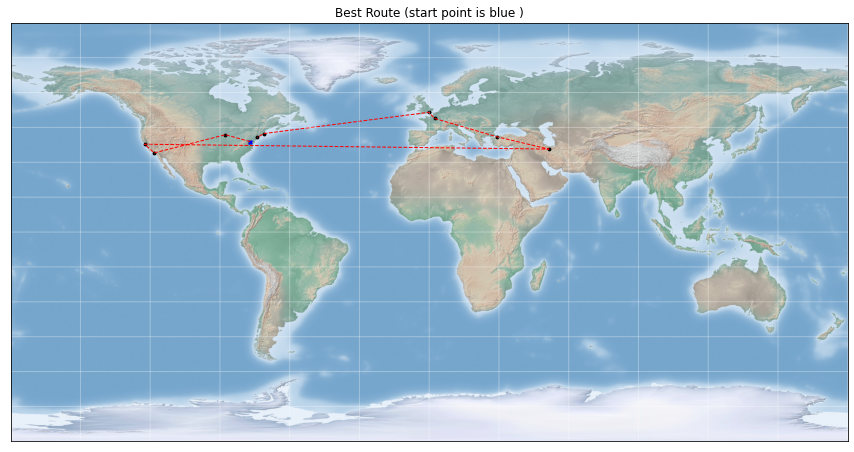

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 - > 100
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 , tourn_size = 25 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 25 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 100

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 24 generations in 2.331005 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . New York
2 . Boston
3 . London
4 . Paris
5 . Istanbul
6 . Tehran
7 . San Francisco
8 . Los Angeles
9 . Chicago
10 . Washington DC


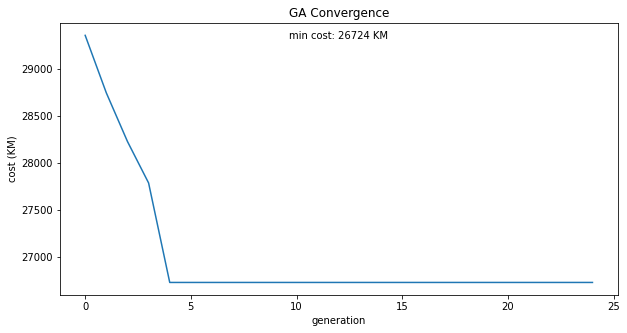

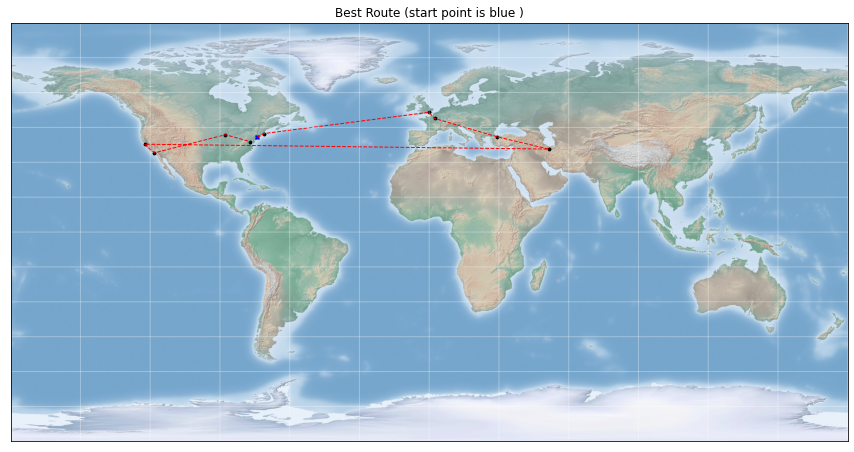

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 - > 100
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 , tourn_size = 100 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 100 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 200

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 26 generations in 3.813025 s
-- TSP-GA -- Minimum travelling cost 27815 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Boston
2 . London
3 . Paris
4 . Istanbul
5 . Tehran
6 . San Francisco
7 . Los Angeles
8 . Chicago
9 . Washington DC
10 . New York


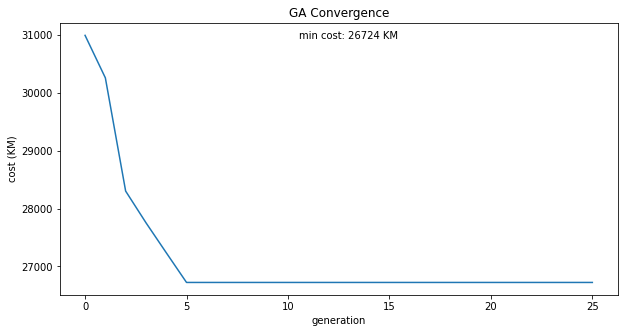

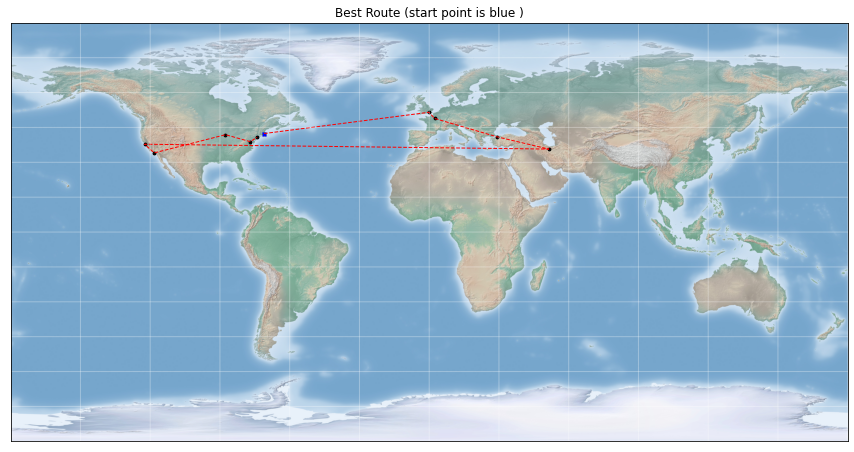

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 - > 200
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 , tourn_size = 200 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 200 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.005

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 29 generations in 1.972691 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Los Angeles
2 . San Francisco
3 . Tehran
4 . Istanbul
5 . Paris
6 . London
7 . Boston
8 . New York
9 . Washington DC
10 . Chicago


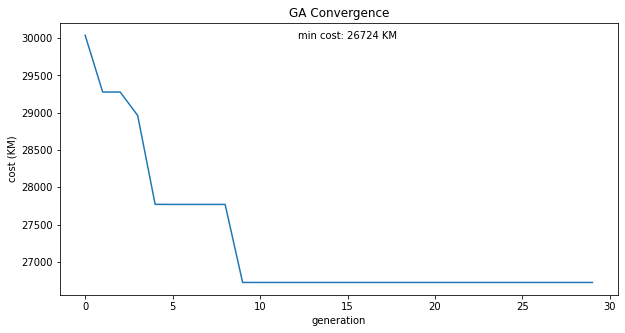

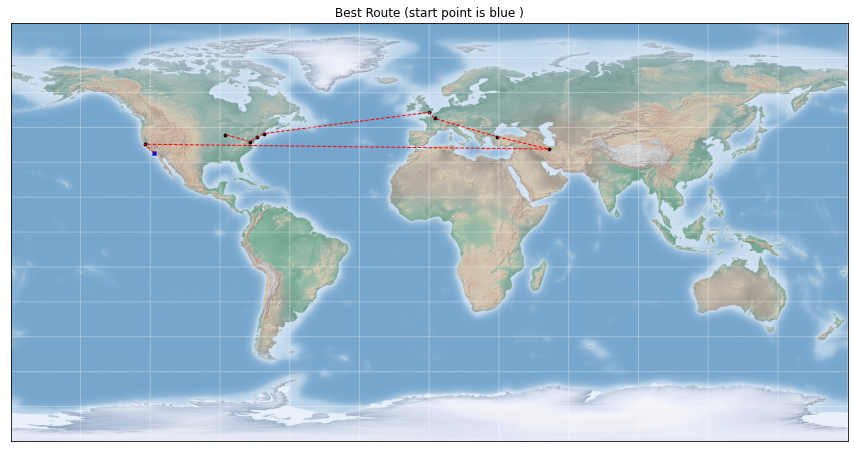

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.005
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 , mut_rate = 0.005 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.005 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.01

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 28 generations in 2.002919 s
-- TSP-GA -- Minimum travelling cost 27815 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Tehran
2 . Istanbul
3 . Paris
4 . London
5 . Boston
6 . New York
7 . Washington DC
8 . Chicago
9 . Los Angeles
10 . San Francisco


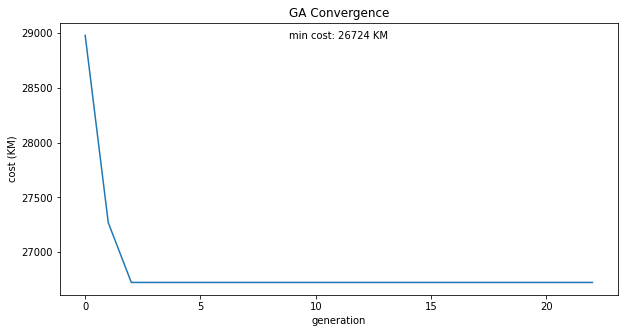

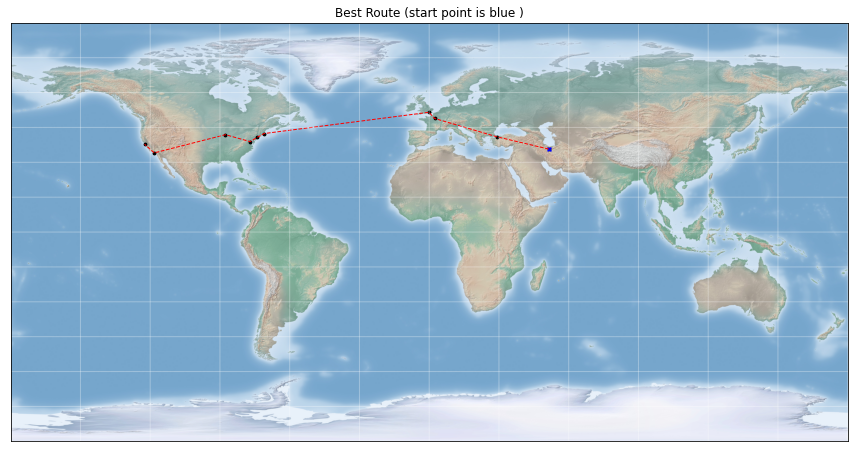

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.01
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 , mut_rate = 0.01 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.01 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.025

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 24 generations in 1.719519 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Tehran
2 . Istanbul
3 . Paris
4 . London
5 . Boston
6 . New York
7 . Washington DC
8 . Chicago
9 . Los Angeles
10 . San Francisco


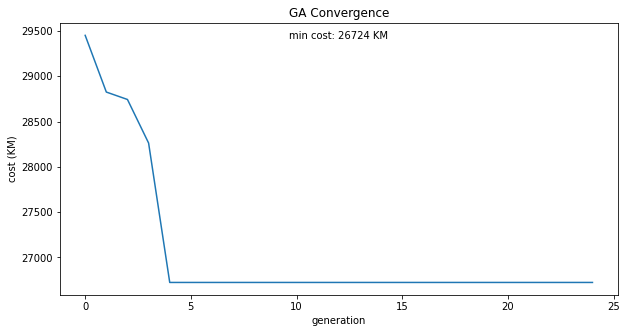

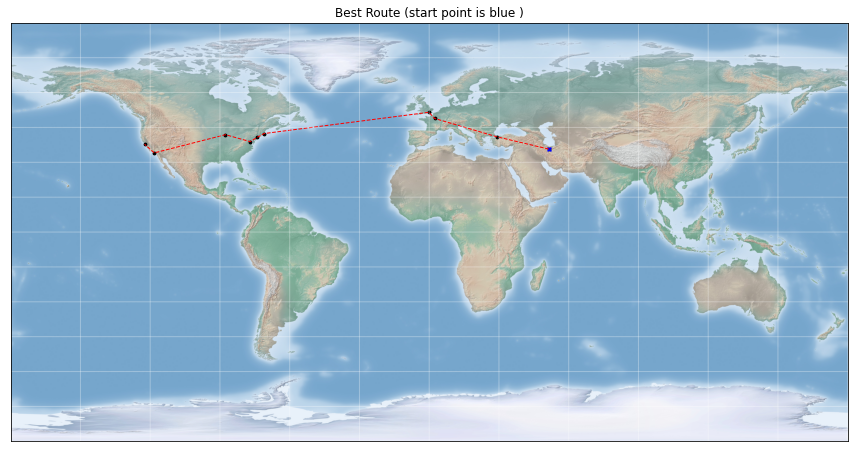

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.025
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 , mut_rate = 0.025 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.025 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.05

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 22 generations in 1.63479 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Boston
2 . New York
3 . Washington DC
4 . Chicago
5 . Los Angeles
6 . San Francisco
7 . Tehran
8 . Istanbul
9 . Paris
10 . London


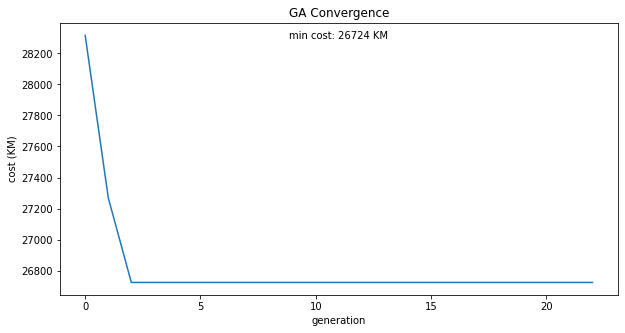

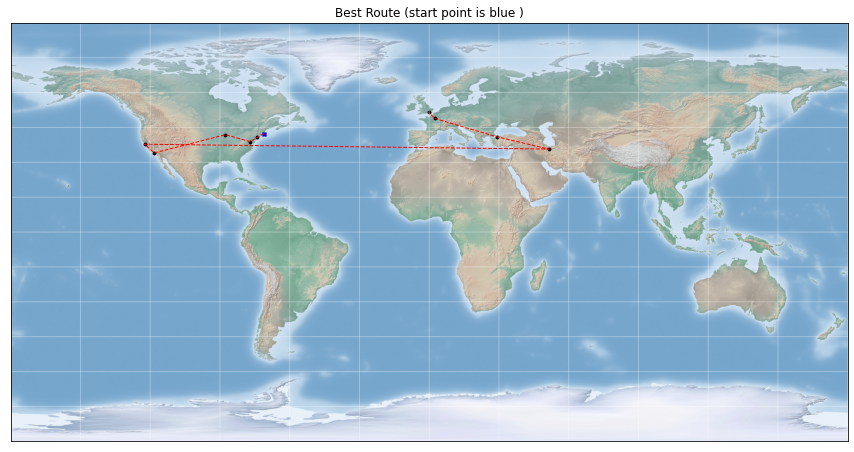

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.05
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 , mut_rate = 0.05 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.05 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.1

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 33 generations in 2.399206 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . San Francisco
2 . Tehran
3 . Istanbul
4 . Paris
5 . London
6 . Boston
7 . New York
8 . Washington DC
9 . Chicago
10 . Los Angeles


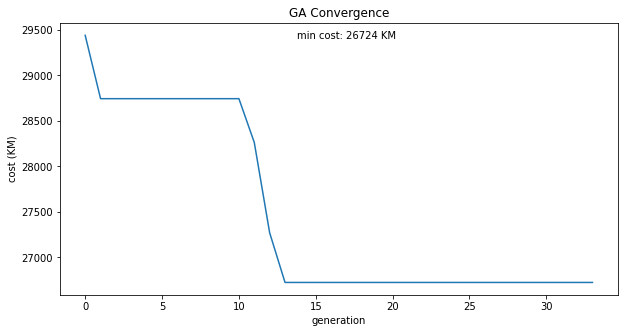

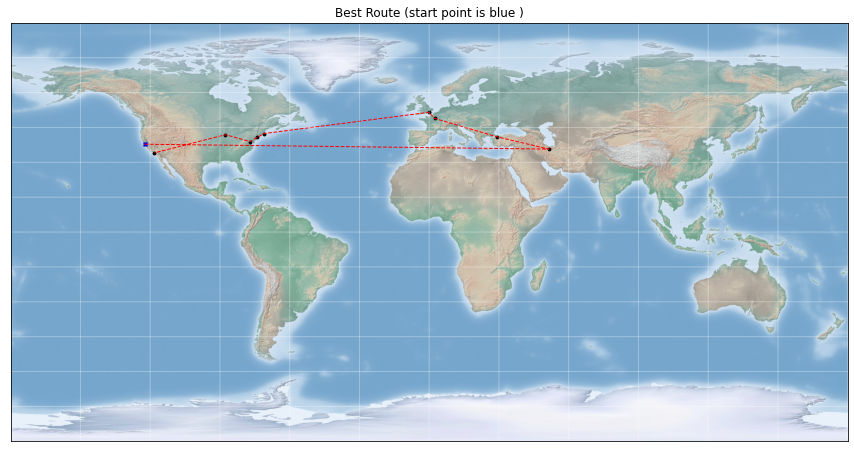

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.1
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 , mut_rate = 0.1 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.1 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 750 & tourn size = 25 & mut_rate = 0.05

-- Running TSP-GA with 10 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 21 generations in 2.34843 s
-- TSP-GA -- Minimum travelling cost 26724 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . New York
2 . Boston
3 . London
4 . Paris
5 . Istanbul
6 . Tehran
7 . San Francisco
8 . Los Angeles
9 . Chicago
10 . Washington DC


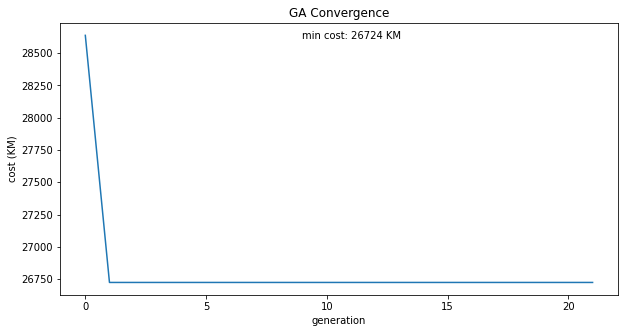

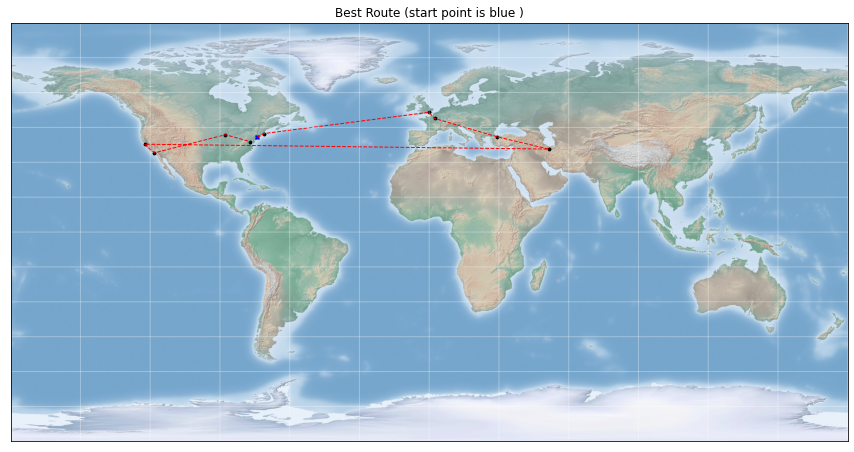

In [ ]:
'''
-------------------
parameters :
-------------------
verbose = 1
pop_size = 500 - > 750
tourn_size = 50 - > 25
mut_rate = 0.02 - > 0.05
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 750 ,tourn_size = 25,  mut_rate = 0.05 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,pop_size = 750 ,tourn_size = 25 , mut_rate = 0.05 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

# 20 Cities

In [22]:
# 20 cities
cities = """New York,USA
Shiraz,Iran
Mashhad,Iran
Houston,USA
Philadelphia,USA
Berlin,Germany
Hamburg,Germany
Tokyo,Japan
Delhi,India
Shanghai,China
Mexico City,Mexico
Los Angeles,USA
Chicago,USA
London,UK
Paris,France
Tehran,Iran
Istanbul,Turkey
San Francisco,USA
Washington DC,USA
Boston,USA"""

In [23]:
result = get_city_country(cities)
dataset = make_dataset(result[0],result[1])
dataset = fill_lat_lng(dataset)
dataset.head()

['New York', 'Shiraz', 'Mashhad', 'Houston', 'Philadelphia', 'Berlin', 'Hamburg', 'Tokyo', 'Delhi', 'Shanghai', 'Mexico City', 'Los Angeles', 'Chicago', 'London', 'Paris', 'Tehran', 'Istanbul', 'San Francisco', 'Washington DC', 'Boston']
['USA', 'Iran', 'Iran', 'USA', 'USA', 'Germany', 'Germany', 'Japan', 'India', 'China', 'Mexico', 'USA', 'USA', 'UK', 'France', 'Iran', 'Turkey', 'USA', 'USA', 'USA']


,City,Country,lat,lng
City,,,,
New York,New York,USA,40.712728,-74.006015
Shiraz,Shiraz,Iran,29.606022,52.537804
Mashhad,Mashhad,Iran,36.297494,59.605923
Houston,Houston,USA,29.758938,-95.367697
Philadelphia,Philadelphia,USA,39.952724,-75.163526


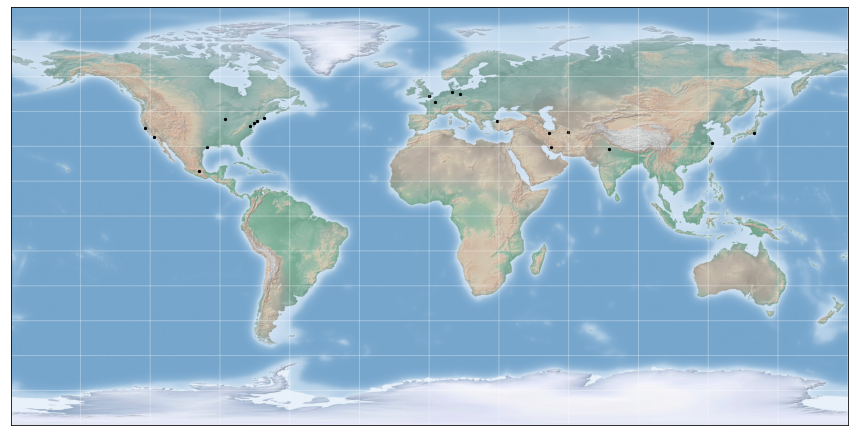

In [24]:
draw_cities_in_map(dataset)

## defult parameters

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 37 generations in 2.794002 s
-- TSP-GA -- Minimum travelling cost 41483 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Los Angeles
2 . San Francisco
3 . Tokyo
4 . Shanghai
5 . Delhi
6 . Mashhad
7 . Shiraz
8 . Tehran
9 . Istanbul
10 . Berlin
11 . Hamburg
12 . Paris
13 . London
14 . Boston
15 . New York
16 . Philadelphia
17 . Washington DC
18 . Chicago
19 . Houston
20 . Mexico City


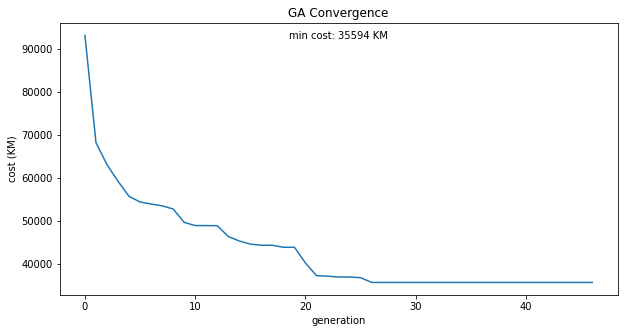

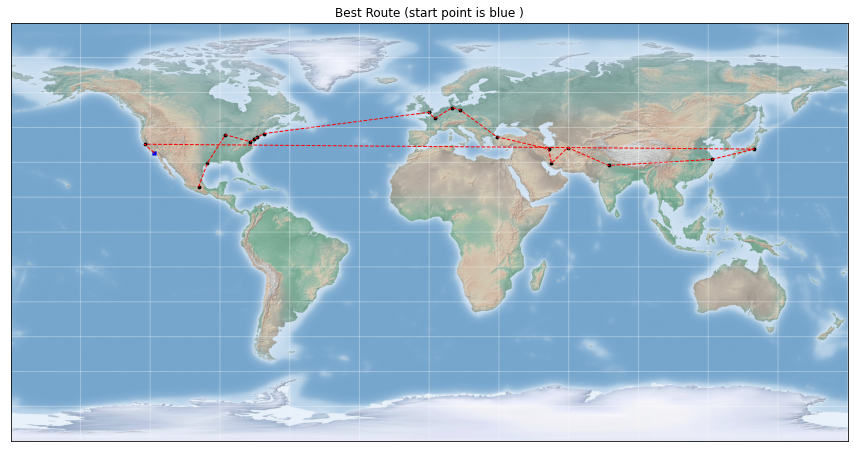

In [ ]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 100

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 71 generations in 0.646828 s
-- TSP-GA -- Minimum travelling cost 55147 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . San Francisco
2 . Los Angeles
3 . Mexico City
4 . Houston
5 . Chicago
6 . Washington DC
7 . Philadelphia
8 . New York
9 . Boston
10 . London
11 . Paris
12 . Hamburg
13 . Berlin
14 . Istanbul
15 . Tehran
16 . Shiraz
17 . Mashhad
18 . Delhi
19 . Shanghai
20 . Tokyo


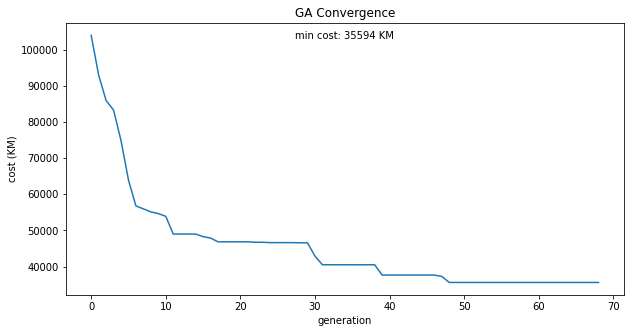

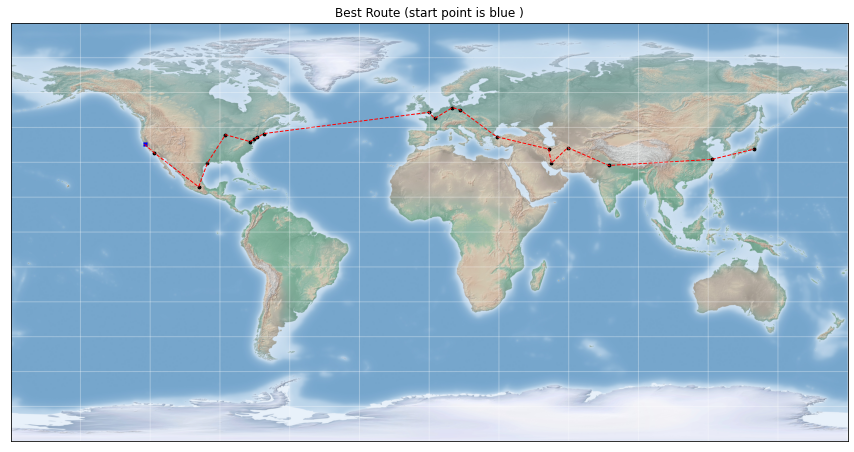

In [ ]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 - > 100
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 100 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,pop_size = 100 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 200

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 51 generations in 1.135217 s
-- TSP-GA -- Minimum travelling cost 61377 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Los Angeles
2 . Mexico City
3 . Houston
4 . Chicago
5 . Washington DC
6 . Philadelphia
7 . New York
8 . Boston
9 . London
10 . Paris
11 . Hamburg
12 . Berlin
13 . Istanbul
14 . Tehran
15 . Shiraz
16 . Mashhad
17 . Delhi
18 . Shanghai
19 . Tokyo
20 . San Francisco


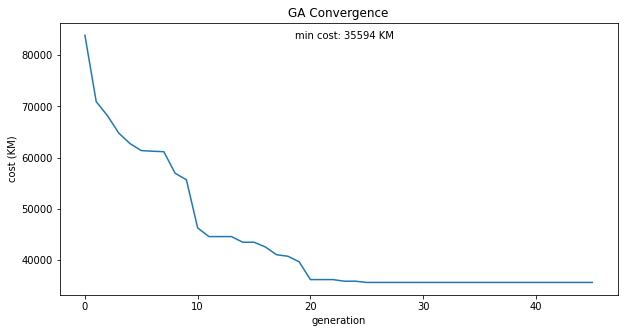

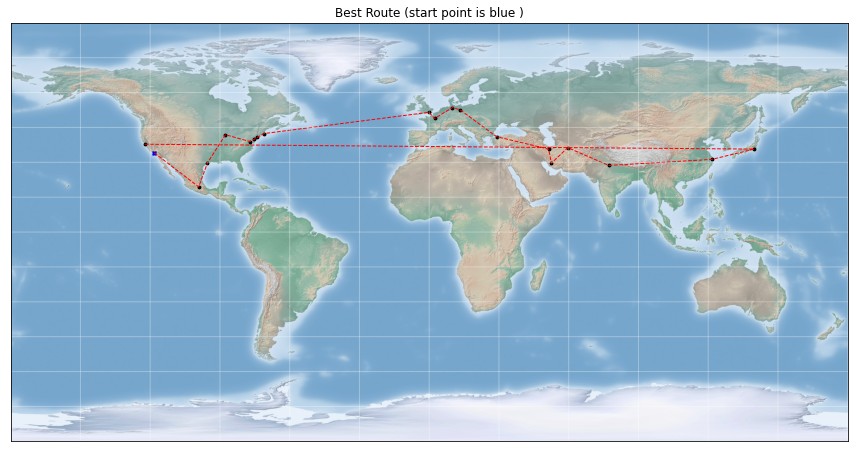

In [ ]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 -> 200
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 200 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,pop_size = 200 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 750

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 32 generations in 4.457735 s
-- TSP-GA -- Minimum travelling cost 35594 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Houston
2 . Chicago
3 . Washington DC
4 . Philadelphia
5 . New York
6 . Boston
7 . London
8 . Paris
9 . Hamburg
10 . Berlin
11 . Istanbul
12 . Tehran
13 . Shiraz
14 . Mashhad
15 . Delhi
16 . Shanghai
17 . Tokyo
18 . San Francisco
19 . Los Angeles
20 . Mexico City


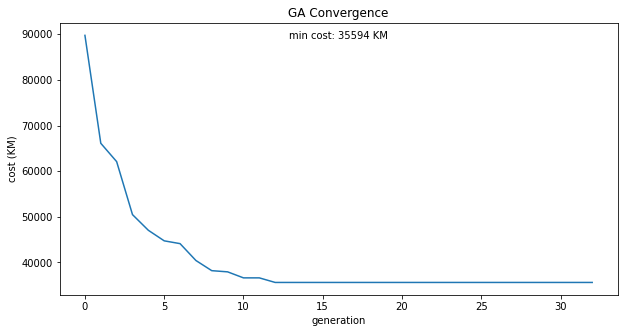

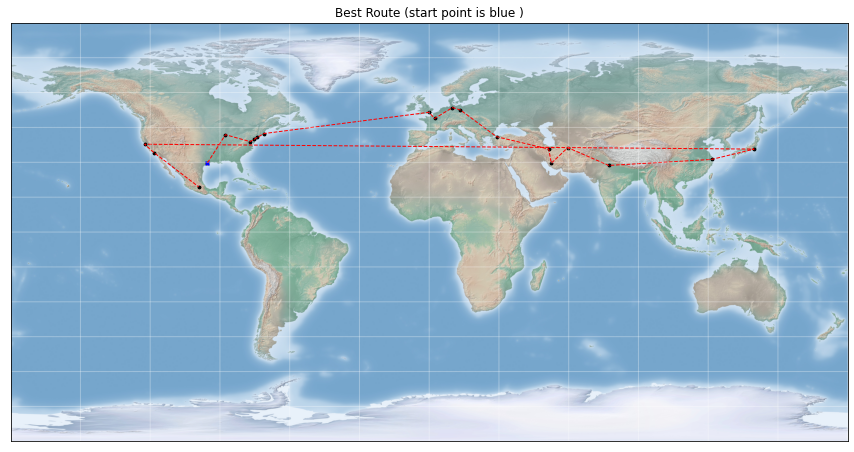

In [ ]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 -> 750
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 750 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,pop_size = 750 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 1000

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 30 generations in 7.034297 s
-- TSP-GA -- Minimum travelling cost 50178 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Chicago
2 . Washington DC
3 . Philadelphia
4 . New York
5 . Boston
6 . London
7 . Paris
8 . Hamburg
9 . Berlin
10 . Istanbul
11 . Tehran
12 . Shiraz
13 . Mashhad
14 . Delhi
15 . Shanghai
16 . Tokyo
17 . San Francisco
18 . Los Angeles
19 . Mexico City
20 . Houston


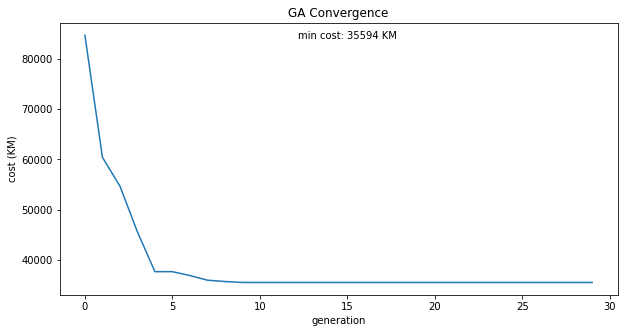

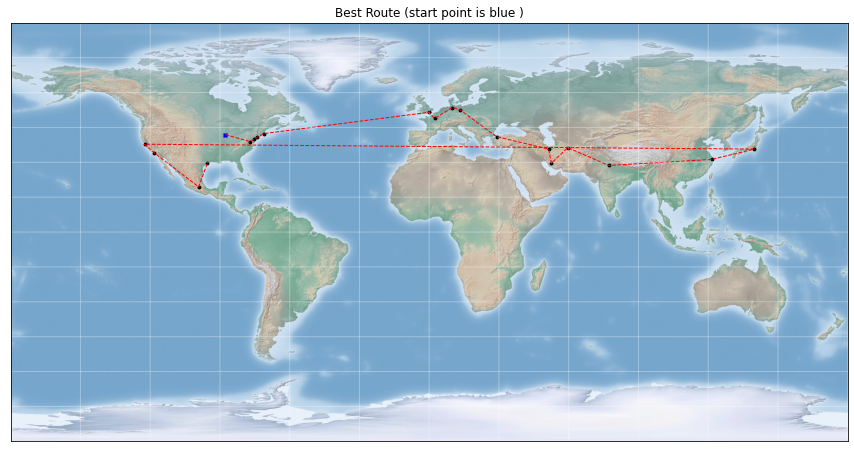

In [ ]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 -> 1000
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 1000 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,pop_size = 1000 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 1


-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 92 generations in 4.757038 s
-- TSP-GA -- Minimum travelling cost 35594 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Tokyo
2 . Shanghai
3 . Delhi
4 . Mashhad
5 . Shiraz
6 . Tehran
7 . Istanbul
8 . Berlin
9 . Hamburg
10 . Paris
11 . London
12 . Boston
13 . New York
14 . Philadelphia
15 . Washington DC
16 . Chicago
17 . Houston
18 . Mexico City
19 . Los Angeles
20 . San Francisco


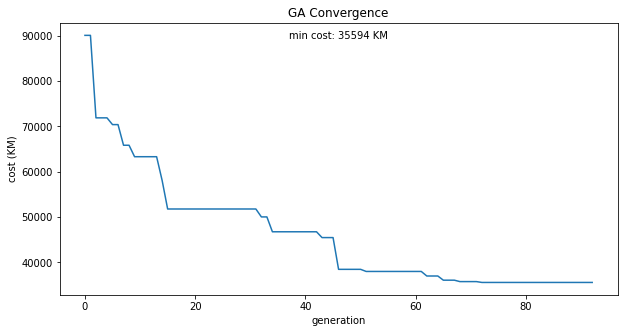

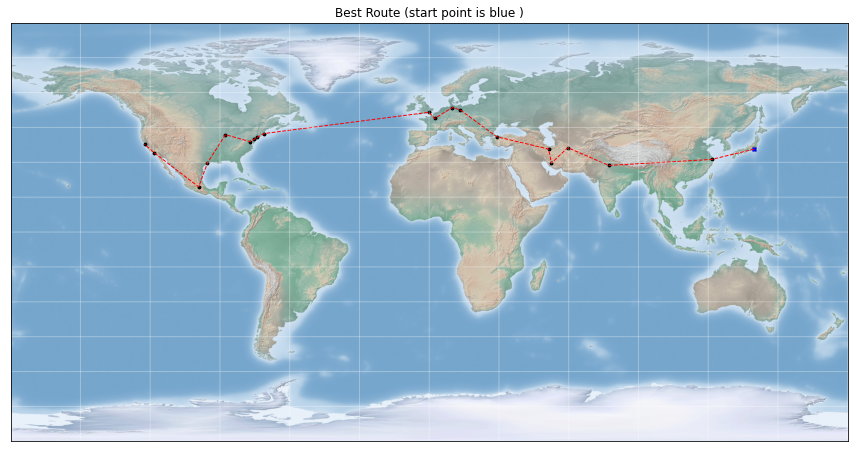

In [ ]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 -> 1
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,tourn_size = 1 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 1 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 10

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 35 generations in 2.065726 s
-- TSP-GA -- Minimum travelling cost 35594 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Los Angeles
2 . San Francisco
3 . Tokyo
4 . Shanghai
5 . Delhi
6 . Mashhad
7 . Shiraz
8 . Tehran
9 . Istanbul
10 . Berlin
11 . Hamburg
12 . Paris
13 . London
14 . Boston
15 . New York
16 . Philadelphia
17 . Washington DC
18 . Chicago
19 . Houston
20 . Mexico City


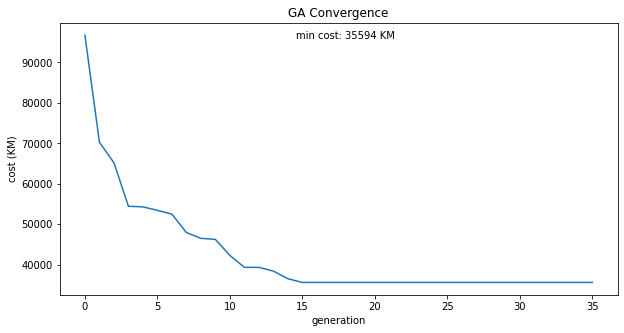

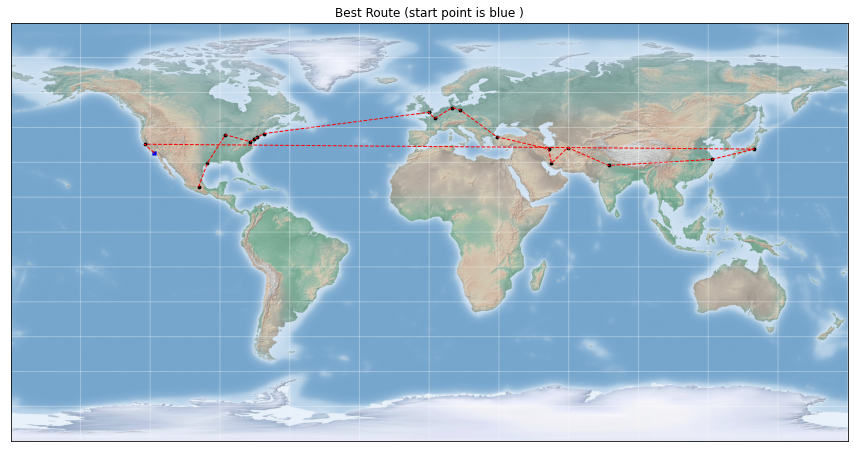

In [ ]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 -> 10
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,tourn_size = 10 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 10 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 25

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 36 generations in 2.380328 s
-- TSP-GA -- Minimum travelling cost 48377 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Tehran
2 . Shiraz
3 . Mashhad
4 . Delhi
5 . Shanghai
6 . Tokyo
7 . San Francisco
8 . Los Angeles
9 . Mexico City
10 . Houston
11 . Chicago
12 . Washington DC
13 . Philadelphia
14 . New York
15 . Boston
16 . London
17 . Paris
18 . Hamburg
19 . Berlin
20 . Istanbul


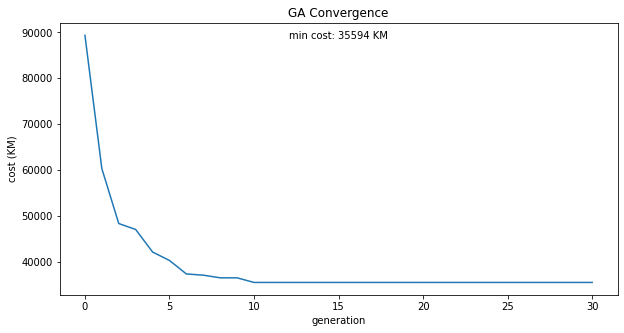

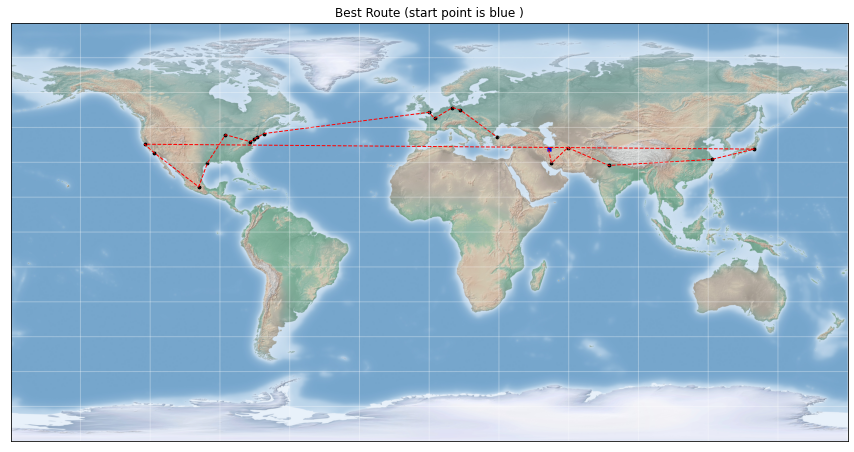

In [ ]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 -> 25
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,tourn_size = 25 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 25 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 100

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 33 generations in 3.520108 s
-- TSP-GA -- Minimum travelling cost 46709 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Los Angeles
2 . Mexico City
3 . Houston
4 . Chicago
5 . Washington DC
6 . Philadelphia
7 . New York
8 . Boston
9 . London
10 . Paris
11 . Hamburg
12 . Berlin
13 . Istanbul
14 . Tehran
15 . Shiraz
16 . Mashhad
17 . Delhi
18 . Shanghai
19 . Tokyo
20 . San Francisco


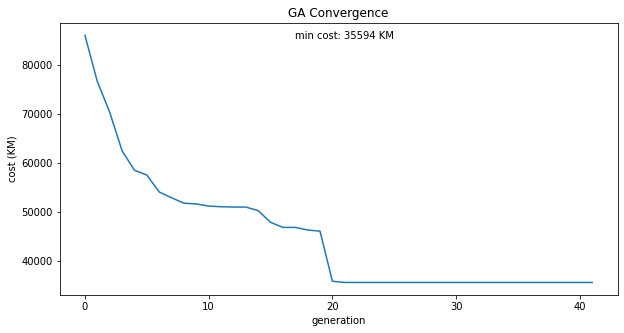

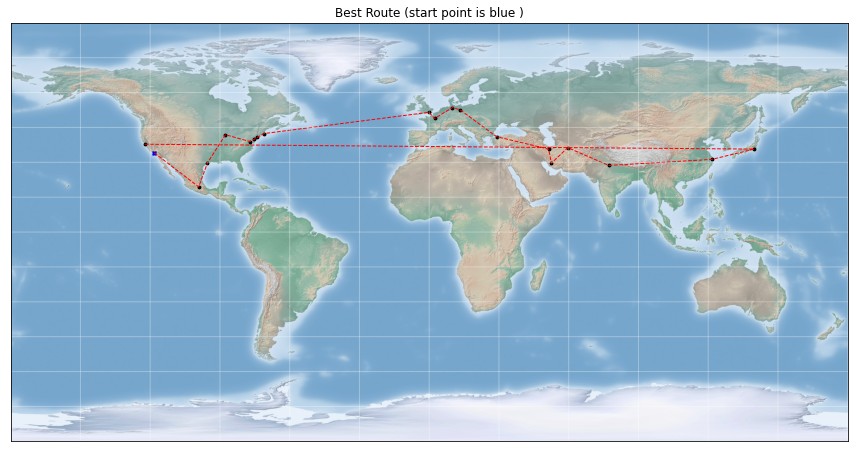

In [ ]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 -> 100
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,tourn_size = 100 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 100 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 200

In [ ]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 -> 200
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,tourn_size = 200 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 200 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 40 generations in 6.18072 s
-- TSP-GA -- Minimum travelling cost 55193 KM
-- Done --


## mut_rate = 0.005

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 38 generations in 2.739364 s
-- TSP-GA -- Minimum travelling cost 35594 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Mexico City
2 . Houston
3 . Chicago
4 . Washington DC
5 . Philadelphia
6 . New York
7 . Boston
8 . London
9 . Paris
10 . Hamburg
11 . Berlin
12 . Istanbul
13 . Tehran
14 . Shiraz
15 . Mashhad
16 . Delhi
17 . Shanghai
18 . Tokyo
19 . San Francisco
20 . Los Angeles


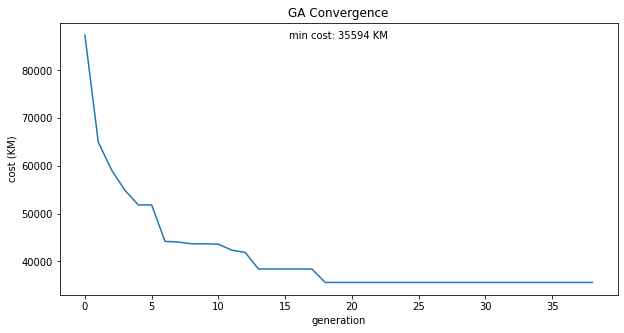

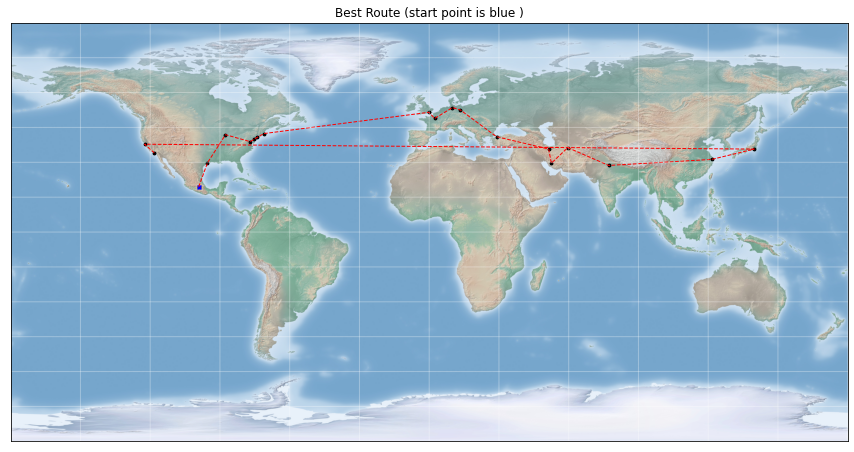

In [25]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.005
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,mut_rate = 0.005 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.005 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.01

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 52 generations in 3.865026 s
-- TSP-GA -- Minimum travelling cost 40380 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Delhi
2 . Shanghai
3 . Tokyo
4 . San Francisco
5 . Los Angeles
6 . Mexico City
7 . Houston
8 . Chicago
9 . Washington DC
10 . Philadelphia
11 . New York
12 . Boston
13 . London
14 . Paris
15 . Hamburg
16 . Berlin
17 . Istanbul
18 . Tehran
19 . Shiraz
20 . Mashhad


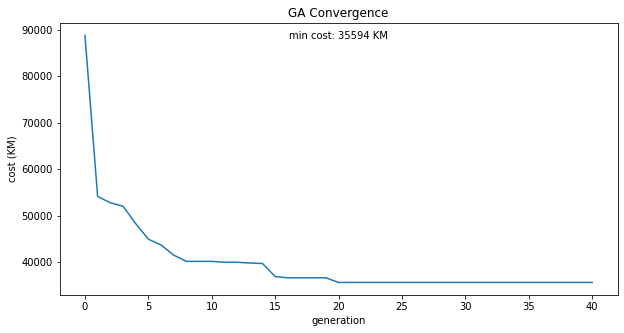

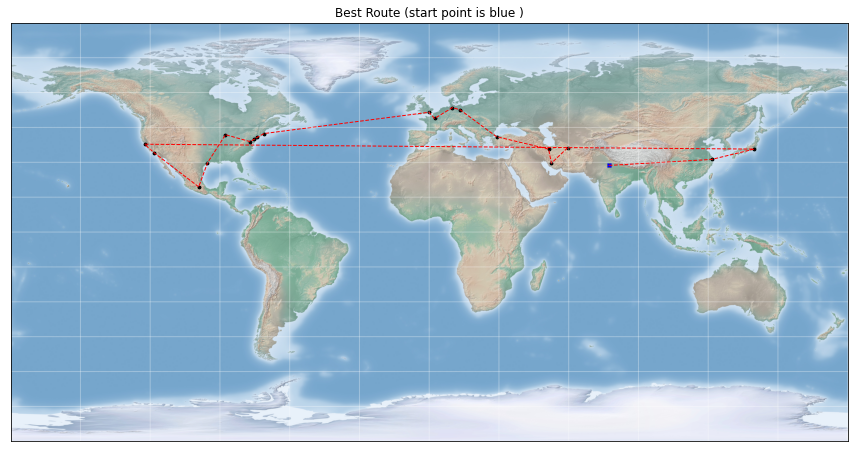

In [26]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.01
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,mut_rate = 0.01 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.01 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.025

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 44 generations in 3.366319 s
-- TSP-GA -- Minimum travelling cost 41725 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . San Francisco
2 . Los Angeles
3 . Mexico City
4 . Houston
5 . Chicago
6 . Washington DC
7 . Philadelphia
8 . New York
9 . Boston
10 . London
11 . Paris
12 . Hamburg
13 . Berlin
14 . Istanbul
15 . Tehran
16 . Shiraz
17 . Mashhad
18 . Delhi
19 . Shanghai
20 . Tokyo


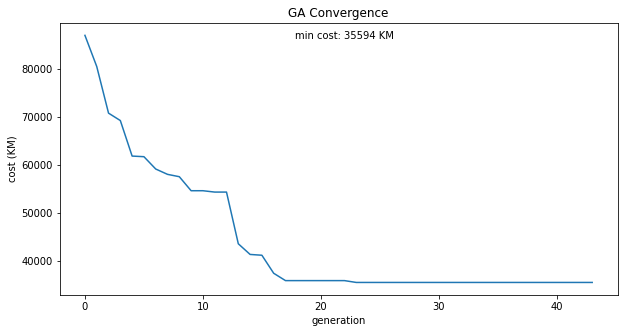

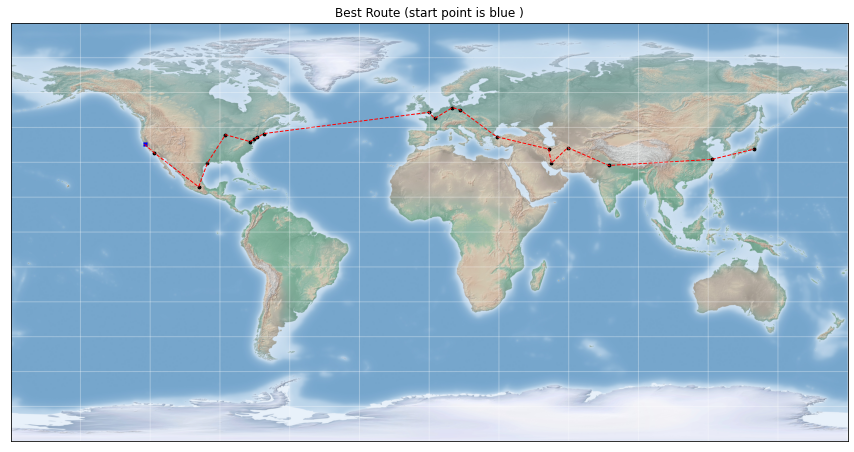

In [27]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.025
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,mut_rate = 0.025 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.025 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.1

-- Running TSP-GA with 20 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 31 generations in 2.517703 s
-- TSP-GA -- Minimum travelling cost 41698 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Delhi
2 . Mashhad
3 . Shiraz
4 . Tehran
5 . Istanbul
6 . Berlin
7 . Hamburg
8 . Paris
9 . London
10 . Boston
11 . New York
12 . Philadelphia
13 . Washington DC
14 . Chicago
15 . Houston
16 . Mexico City
17 . Los Angeles
18 . San Francisco
19 . Tokyo
20 . Shanghai


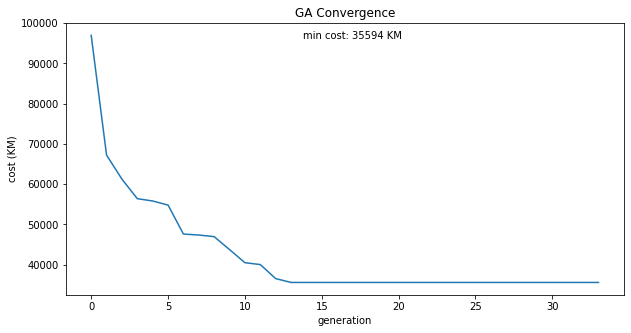

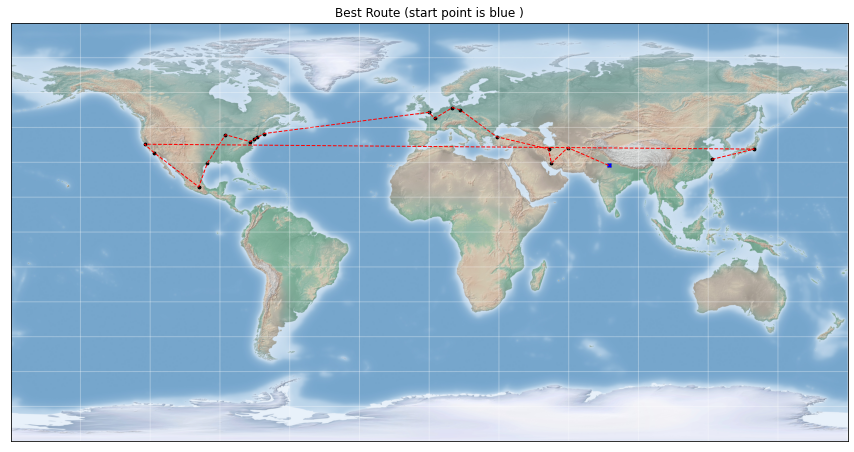

In [28]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.1
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,mut_rate = 0.1 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.1 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

# 50 Cities

In [29]:
# 50 cities
cities = """New York,USA
Nairobi,Kenya
Accra,Ghana
Lagos,Nigeria
Cape Town,South Africa
Johannesburg,South Africa
Dar es Salaam,Tanzania
Addis Ababa,Ethiopia
Luanda,Angola
Kigali,Rwanda
Dakar,Senegal
Kampala,Uganda
Cairo,Egypt
Riyadh,Saudi Arabia
Alexandria,Egypt
Aswan,Egypt
Port Said,Egypt
Ankara,Turkey
Izmir,Turkey
Antalya,Turkey
Alanya,Turkey
Shiraz,Iran
Mashhad,Iran
Dallas,USA
Austin,USA
Seoul,South Korea
Busan,South Korea
Gwangju,South Korea
Bangkok,Thailand
Osaka,Japan
Shinjuku City,Japan
Singapore,Singapore
Beijing,China
Houston,USA
Philadelphia,USA
Berlin,Germany
Hamburg,Germany
Tokyo,Japan
Delhi,India
Shanghai,China
Mexico City,Mexico
Los Angeles,USA
Chicago,USA
London,UK
Paris,France
Tehran,Iran
Istanbul,Turkey
San Francisco,USA
Washington DC,USA
Boston,USA"""

In [30]:
result = get_city_country(cities)
dataset = make_dataset(result[0],result[1])
dataset = fill_lat_lng(dataset)
dataset.head()

['New York', 'Nairobi', 'Accra', 'Lagos', 'Cape Town', 'Johannesburg', 'Dar es Salaam', 'Addis Ababa', 'Luanda', 'Kigali', 'Dakar', 'Kampala', 'Cairo', 'Riyadh', 'Alexandria', 'Aswan', 'Port Said', 'Ankara', 'Izmir', 'Antalya', 'Alanya', 'Shiraz', 'Mashhad', 'Dallas', 'Austin', 'Seoul', 'Busan', 'Gwangju', 'Bangkok', 'Osaka', 'Shinjuku City', 'Singapore', 'Beijing', 'Houston', 'Philadelphia', 'Berlin', 'Hamburg', 'Tokyo', 'Delhi', 'Shanghai', 'Mexico City', 'Los Angeles', 'Chicago', 'London', 'Paris', 'Tehran', 'Istanbul', 'San Francisco', 'Washington DC', 'Boston']
['USA', 'Kenya', 'Ghana', 'Nigeria', 'South Africa', 'South Africa', 'Tanzania', 'Ethiopia', 'Angola', 'Rwanda', 'Senegal', 'Uganda', 'Egypt', 'Saudi Arabia', 'Egypt', 'Egypt', 'Egypt', 'Turkey', 'Turkey', 'Turkey', 'Turkey', 'Iran', 'Iran', 'USA', 'USA', 'South Korea', 'South Korea', 'South Korea', 'Thailand', 'Japan', 'Japan', 'Singapore', 'China', 'USA', 'USA', 'Germany', 'Germany', 'Japan', 'India', 'China', 'Mexico', '

,City,Country,lat,lng
City,,,,
New York,New York,USA,40.712728,-74.006015
Nairobi,Nairobi,Kenya,-1.283253,36.817245
Accra,Accra,Ghana,5.560014,-0.205744
Lagos,Lagos,Nigeria,6.455057,3.394179
Cape Town,Cape Town,South Africa,-33.928992,18.417396


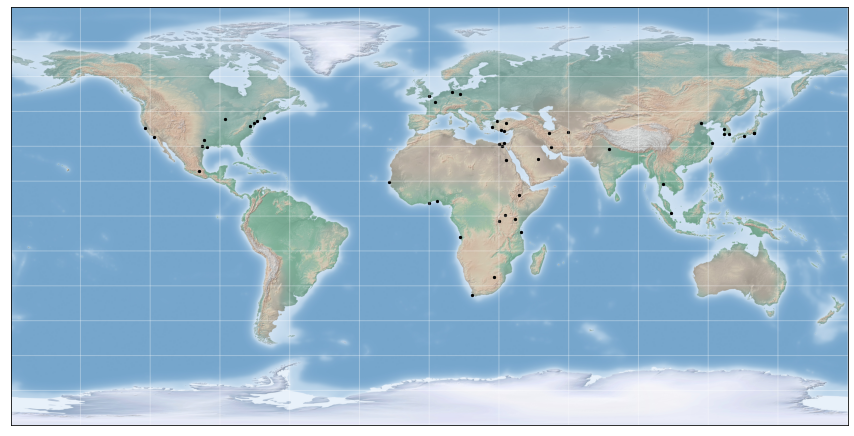

In [31]:
draw_cities_in_map(dataset)

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 118 generations in 11.288448 s
-- TSP-GA -- Minimum travelling cost 118577 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Dallas
2 . Austin
3 . Houston
4 . Mexico City
5 . Los Angeles
6 . San Francisco
7 . Seoul
8 . Bangkok
9 . Singapore
10 . Shanghai
11 . Gwangju
12 . Busan
13 . Osaka
14 . Shinjuku City
15 . Tokyo
16 . Beijing
17 . Delhi
18 . Mashhad
19 . Tehran
20 . Shiraz
21 . Riyadh
22 . Port Said
23 . Alexandria
24 . Alanya
25 . Antalya
26 . Izmir
27 . Ankara
28 . Istanbul
29 . Berlin
30 . Hamburg
31 . Paris
32 . Dakar
33 . Accra
34 . Lagos
35 . Luanda
36 . Cape Town
37 . Johannesburg
38 . Dar es Salaam
39 . Kigali
40 . Kampala
41 . Nairobi
42 . Addis Ababa
43 . Aswan
44 . Cairo
45 . London
46 . Boston
47 . New York
48 . Philadelphia
49 . Washington DC
50 . Chicago


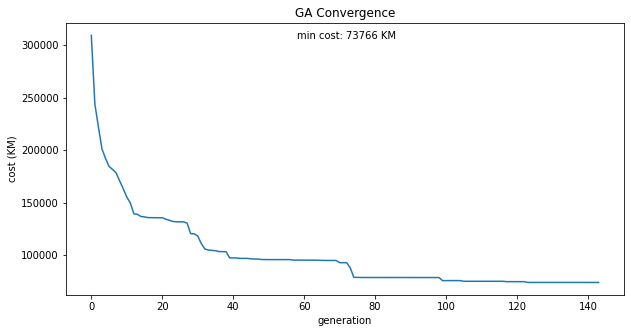

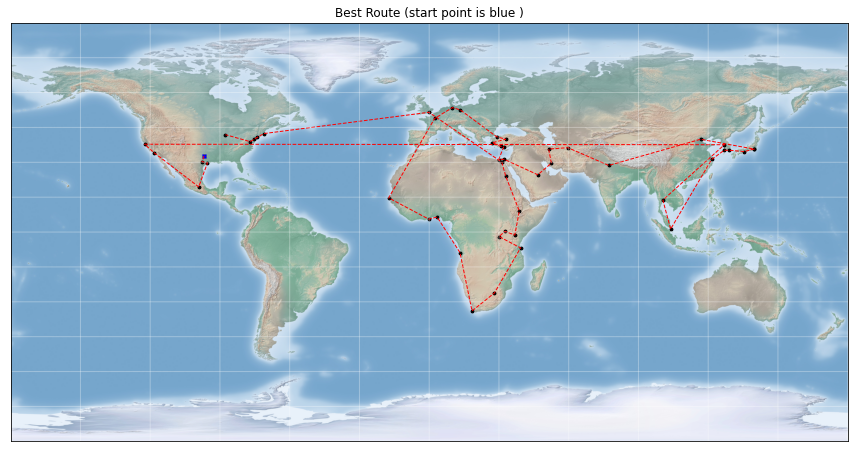

In [32]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 100

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 177 generations in 2.476606 s
-- TSP-GA -- Minimum travelling cost 127567 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Istanbul
2 . Antalya
3 . Alexandria
4 . Port Said
5 . Alanya
6 . Ankara
7 . Tokyo
8 . Shinjuku City
9 . Osaka
10 . Mashhad
11 . Tehran
12 . Shiraz
13 . Delhi
14 . Beijing
15 . Gwangju
16 . Busan
17 . Seoul
18 . Shanghai
19 . Bangkok
20 . Singapore
21 . Johannesburg
22 . Cape Town
23 . Luanda
24 . Accra
25 . Mexico City
26 . Los Angeles
27 . San Francisco
28 . Austin
29 . Houston
30 . Dallas
31 . Chicago
32 . Washington DC
33 . Philadelphia
34 . New York
35 . Boston
36 . Dakar
37 . Lagos
38 . Kigali
39 . Kampala
40 . Nairobi
41 . Dar es Salaam
42 . Addis Ababa
43 . Riyadh
44 . Aswan
45 . Cairo
46 . Izmir
47 . Paris
48 . London
49 . Hamburg
50 . Berlin


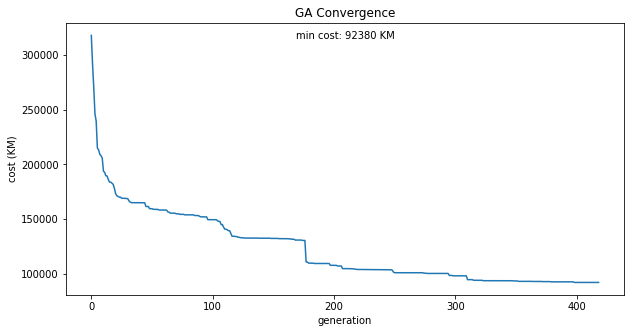

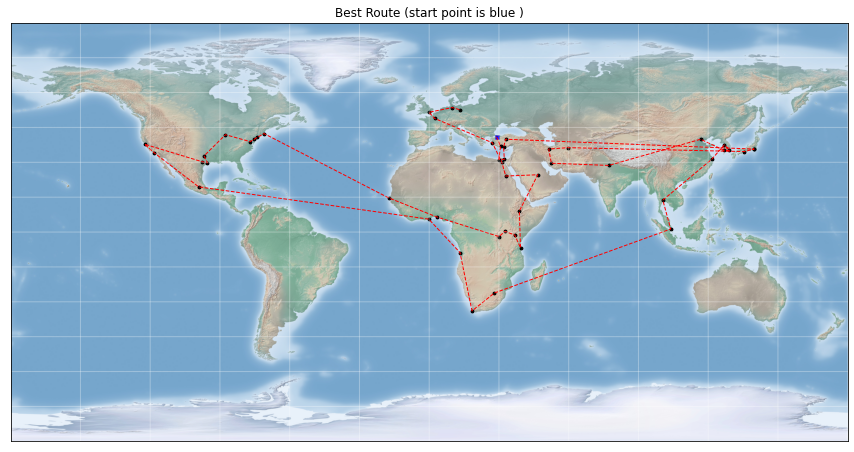

In [34]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 - > 100
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 100 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,pop_size = 100,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## pop size = 750

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 83 generations in 14.411217 s
-- TSP-GA -- Minimum travelling cost 98054 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Cairo
2 . Port Said
3 . Aswan
4 . Addis Ababa
5 . Kampala
6 . Kigali
7 . Luanda
8 . Cape Town
9 . Johannesburg
10 . Dar es Salaam
11 . Nairobi
12 . Delhi
13 . Bangkok
14 . Singapore
15 . Shanghai
16 . Osaka
17 . Tokyo
18 . Shinjuku City
19 . Busan
20 . Gwangju
21 . Seoul
22 . Beijing
23 . Mashhad
24 . Shiraz
25 . Riyadh
26 . Tehran
27 . Berlin
28 . Hamburg
29 . Istanbul
30 . Izmir
31 . Lagos
32 . Accra
33 . Dakar
34 . Boston
35 . New York
36 . Philadelphia
37 . Washington DC
38 . Chicago
39 . San Francisco
40 . Los Angeles
41 . Mexico City
42 . Houston
43 . Austin
44 . Dallas
45 . London
46 . Paris
47 . Ankara
48 . Antalya
49 . Alanya
50 . Alexandria


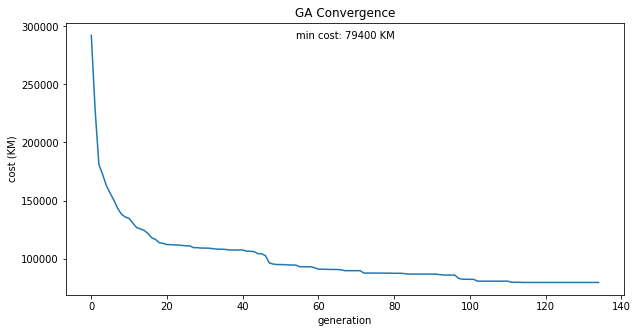

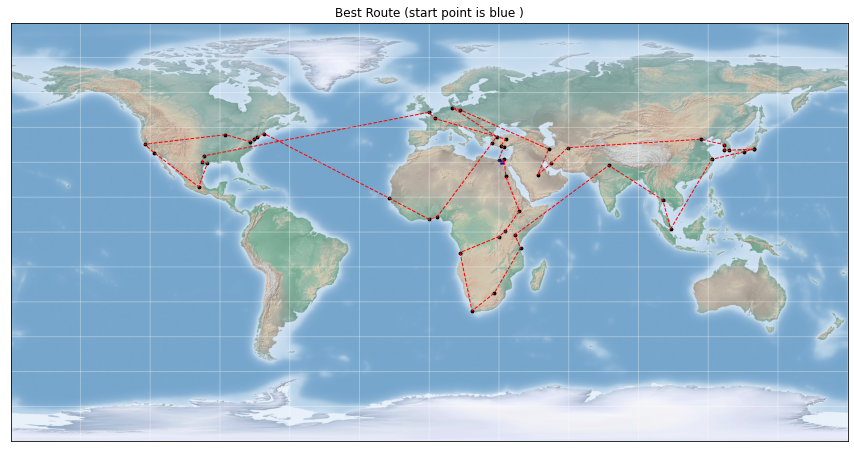

In [35]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 - > 750
tourn_size = 50
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,pop_size = 750 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,pop_size = 750,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 1

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 154 generations in 10.447152 s
-- TSP-GA -- Minimum travelling cost 123532 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Tokyo
2 . Shinjuku City
3 . Osaka
4 . Busan
5 . Gwangju
6 . Seoul
7 . Beijing
8 . Shanghai
9 . Singapore
10 . Bangkok
11 . Delhi
12 . Mashhad
13 . Shiraz
14 . Riyadh
15 . Aswan
16 . Addis Ababa
17 . Nairobi
18 . Kigali
19 . Kampala
20 . Dar es Salaam
21 . Johannesburg
22 . Cape Town
23 . Luanda
24 . Lagos
25 . Accra
26 . Dakar
27 . London
28 . Paris
29 . Izmir
30 . Istanbul
31 . Ankara
32 . Tehran
33 . Port Said
34 . Cairo
35 . Alexandria
36 . Alanya
37 . Antalya
38 . Berlin
39 . Hamburg
40 . Boston
41 . New York
42 . Philadelphia
43 . Washington DC
44 . Chicago
45 . Dallas
46 . Austin
47 . Houston
48 . Mexico City
49 . Los Angeles
50 . San Francisco


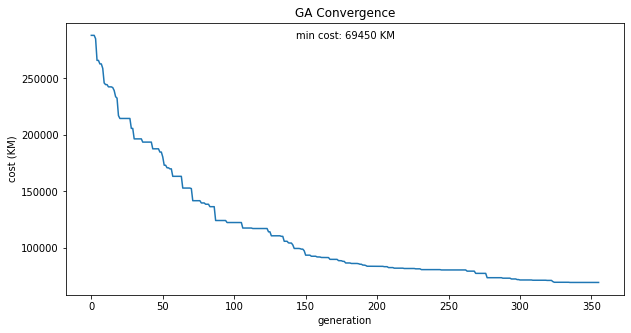

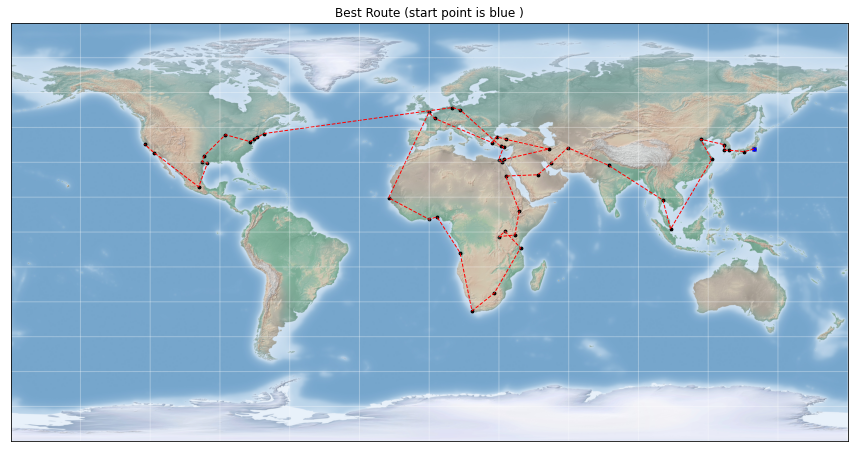

In [36]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 - > 1
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,tourn_size = 1 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 1,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 10

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 132 generations in 10.237553 s
-- TSP-GA -- Minimum travelling cost 101366 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Paris
2 . Hamburg
3 . Berlin
4 . Delhi
5 . Bangkok
6 . Singapore
7 . Shanghai
8 . Gwangju
9 . Shinjuku City
10 . Tokyo
11 . Osaka
12 . Busan
13 . Seoul
14 . Beijing
15 . Ankara
16 . Istanbul
17 . Izmir
18 . Antalya
19 . Alanya
20 . Port Said
21 . Alexandria
22 . Cairo
23 . Aswan
24 . Riyadh
25 . Tehran
26 . Mashhad
27 . Shiraz
28 . Addis Ababa
29 . Kampala
30 . Kigali
31 . Nairobi
32 . Dar es Salaam
33 . Johannesburg
34 . Cape Town
35 . Luanda
36 . Lagos
37 . Accra
38 . Dakar
39 . Chicago
40 . San Francisco
41 . Los Angeles
42 . Mexico City
43 . Houston
44 . Austin
45 . Dallas
46 . Washington DC
47 . Philadelphia
48 . New York
49 . Boston
50 . London


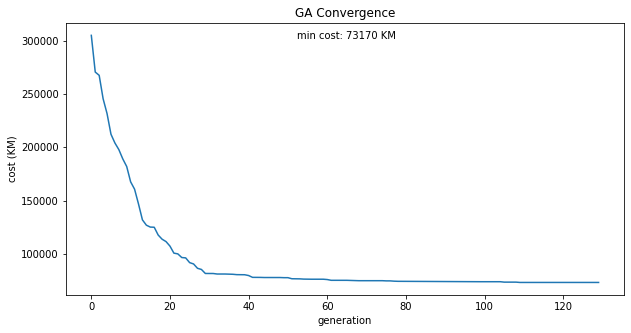

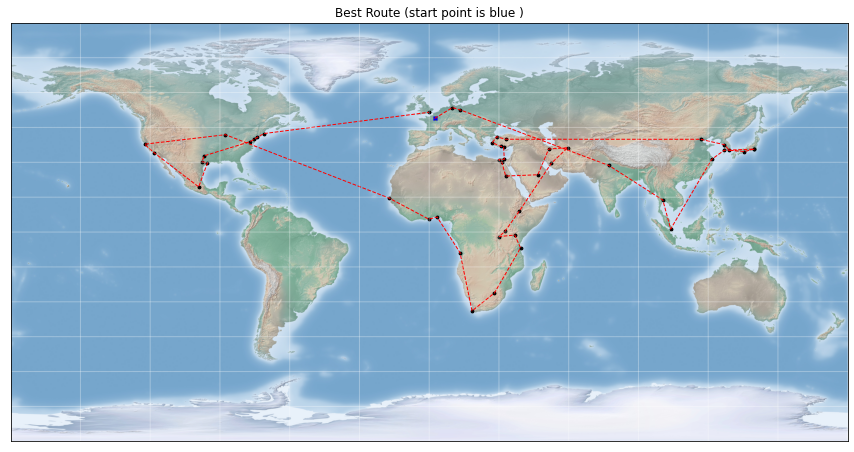

In [37]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 - > 10
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,tourn_size = 10 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 10,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## tourn_size = 100

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 98 generations in 11.871664 s
-- TSP-GA -- Minimum travelling cost 124719 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Accra
2 . Dakar
3 . New York
4 . Boston
5 . Paris
6 . London
7 . Philadelphia
8 . Washington DC
9 . Chicago
10 . Dallas
11 . Austin
12 . Houston
13 . Mexico City
14 . Los Angeles
15 . San Francisco
16 . Tokyo
17 . Shinjuku City
18 . Osaka
19 . Busan
20 . Seoul
21 . Gwangju
22 . Shanghai
23 . Beijing
24 . Tehran
25 . Ankara
26 . Alanya
27 . Antalya
28 . Istanbul
29 . Berlin
30 . Hamburg
31 . Izmir
32 . Alexandria
33 . Port Said
34 . Cairo
35 . Aswan
36 . Addis Ababa
37 . Kampala
38 . Nairobi
39 . Dar es Salaam
40 . Singapore
41 . Bangkok
42 . Delhi
43 . Mashhad
44 . Shiraz
45 . Riyadh
46 . Kigali
47 . Johannesburg
48 . Cape Town
49 . Luanda
50 . Lagos


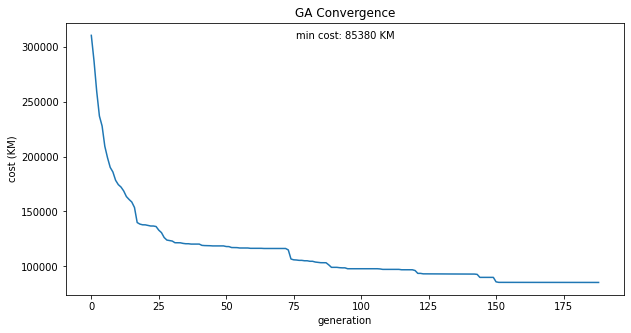

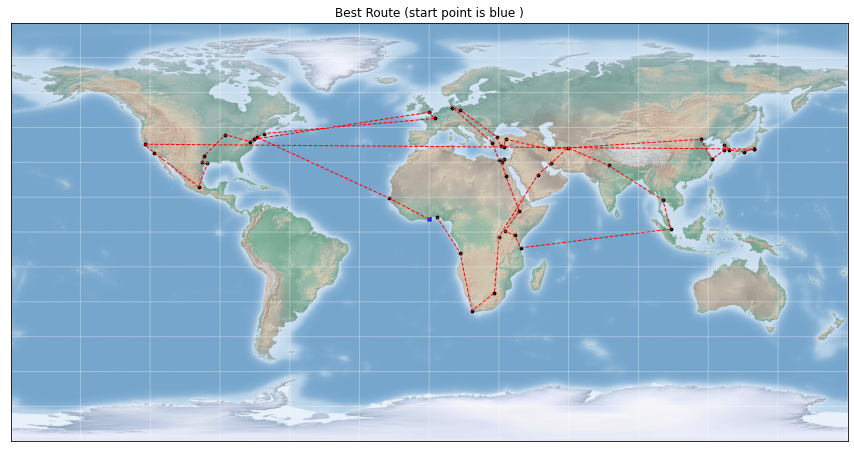

In [38]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 - > 100
mut_rate = 0.02
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,tourn_size = 100 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,tourn_size = 100,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.005

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 110 generations in 9.826128 s
-- TSP-GA -- Minimum travelling cost 112414 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Luanda
2 . Cape Town
3 . Johannesburg
4 . Singapore
5 . Shanghai
6 . Gwangju
7 . Busan
8 . Seoul
9 . Beijing
10 . Hamburg
11 . Berlin
12 . Istanbul
13 . Alexandria
14 . Cairo
15 . Aswan
16 . Port Said
17 . Alanya
18 . Antalya
19 . Paris
20 . London
21 . Boston
22 . New York
23 . Philadelphia
24 . Washington DC
25 . Chicago
26 . Dallas
27 . Austin
28 . Houston
29 . Mexico City
30 . Los Angeles
31 . San Francisco
32 . Tokyo
33 . Shinjuku City
34 . Osaka
35 . Bangkok
36 . Dar es Salaam
37 . Nairobi
38 . Kigali
39 . Kampala
40 . Addis Ababa
41 . Riyadh
42 . Shiraz
43 . Delhi
44 . Mashhad
45 . Tehran
46 . Ankara
47 . Izmir
48 . Dakar
49 . Accra
50 . Lagos


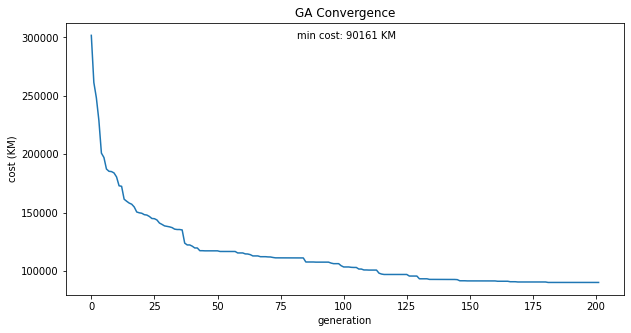

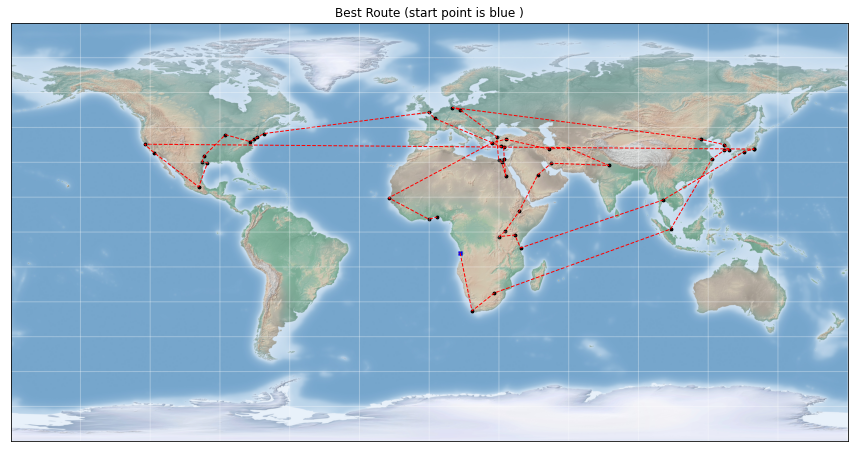

In [39]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.005
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,mut_rate = 0.005 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.005,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.01

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 99 generations in 9.018614 s
-- TSP-GA -- Minimum travelling cost 86743 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Houston
2 . Washington DC
3 . New York
4 . Philadelphia
5 . Dallas
6 . Los Angeles
7 . San Francisco
8 . Tokyo
9 . Shinjuku City
10 . Osaka
11 . Shanghai
12 . Beijing
13 . Seoul
14 . Busan
15 . Gwangju
16 . Mashhad
17 . Antalya
18 . Alanya
19 . Cairo
20 . Aswan
21 . Dar es Salaam
22 . Johannesburg
23 . Cape Town
24 . Luanda
25 . Accra
26 . Lagos
27 . Kigali
28 . Kampala
29 . Nairobi
30 . Addis Ababa
31 . Riyadh
32 . Shiraz
33 . Singapore
34 . Bangkok
35 . Delhi
36 . Tehran
37 . Port Said
38 . Alexandria
39 . Izmir
40 . Ankara
41 . Istanbul
42 . Berlin
43 . London
44 . Hamburg
45 . Paris
46 . Dakar
47 . Boston
48 . Chicago
49 . Austin
50 . Mexico City


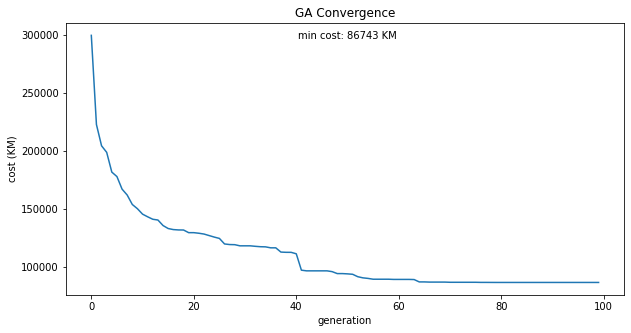

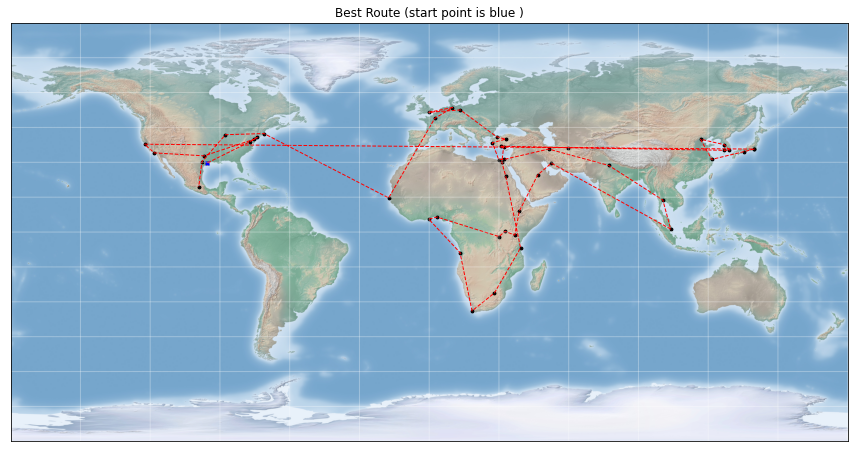

In [40]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.01
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,mut_rate = 0.005 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.005,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.05

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 132 generations in 14.074031 s
-- TSP-GA -- Minimum travelling cost 105077 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Cairo
2 . Aswan
3 . Kigali
4 . Luanda
5 . Lagos
6 . Accra
7 . Dakar
8 . Boston
9 . New York
10 . Philadelphia
11 . Washington DC
12 . Chicago
13 . Dallas
14 . Austin
15 . Houston
16 . Mexico City
17 . Los Angeles
18 . San Francisco
19 . London
20 . Paris
21 . Hamburg
22 . Berlin
23 . Izmir
24 . Alexandria
25 . Port Said
26 . Alanya
27 . Antalya
28 . Istanbul
29 . Ankara
30 . Tehran
31 . Shiraz
32 . Mashhad
33 . Delhi
34 . Bangkok
35 . Singapore
36 . Shanghai
37 . Gwangju
38 . Seoul
39 . Busan
40 . Osaka
41 . Tokyo
42 . Shinjuku City
43 . Beijing
44 . Dar es Salaam
45 . Johannesburg
46 . Cape Town
47 . Kampala
48 . Nairobi
49 . Addis Ababa
50 . Riyadh


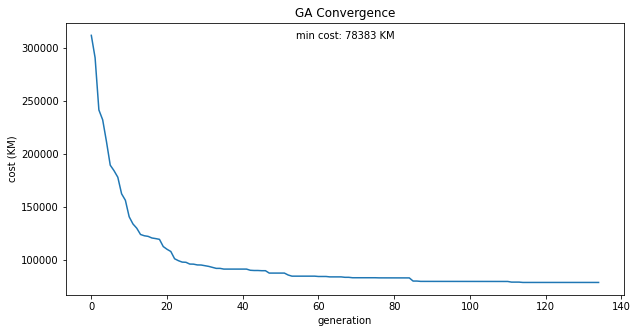

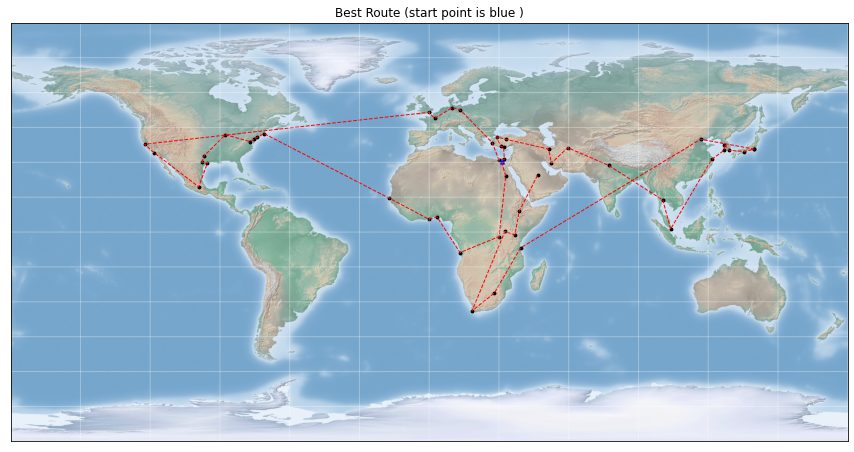

In [41]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.05
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,mut_rate = 0.05 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.05,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.2

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 106 generations in 12.278675 s
-- TSP-GA -- Minimum travelling cost 161194 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Gwangju
2 . Tokyo
3 . Shinjuku City
4 . Beijing
5 . Tehran
6 . Mashhad
7 . Kigali
8 . Nairobi
9 . Cape Town
10 . Johannesburg
11 . Kampala
12 . Dar es Salaam
13 . Cairo
14 . Izmir
15 . Shiraz
16 . Alanya
17 . Port Said
18 . Riyadh
19 . Paris
20 . London
21 . Aswan
22 . Antalya
23 . Boston
24 . Austin
25 . Mexico City
26 . Los Angeles
27 . San Francisco
28 . Chicago
29 . Washington DC
30 . Philadelphia
31 . Dallas
32 . Houston
33 . New York
34 . Berlin
35 . Istanbul
36 . Ankara
37 . Alexandria
38 . Addis Ababa
39 . Accra
40 . Luanda
41 . Lagos
42 . Dakar
43 . Hamburg
44 . Delhi
45 . Osaka
46 . Busan
47 . Shanghai
48 . Bangkok
49 . Singapore
50 . Seoul


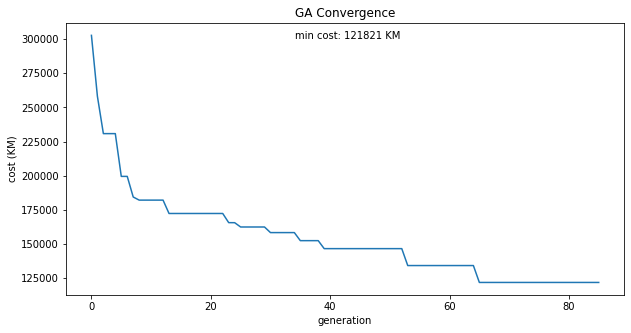

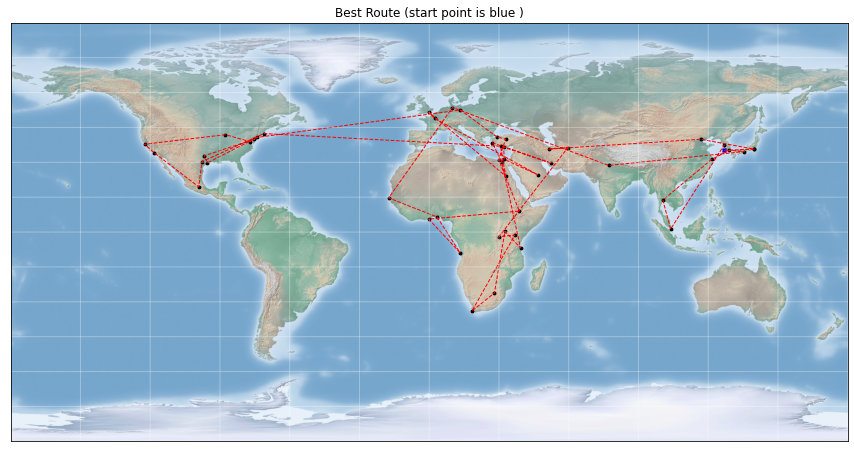

In [42]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.2
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,mut_rate = 0.2 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.2,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.5

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 43 generations in 5.891247 s
-- TSP-GA -- Minimum travelling cost 242826 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Dakar
2 . London
3 . Busan
4 . Osaka
5 . Seoul
6 . Cape Town
7 . Luanda
8 . Bangkok
9 . Shanghai
10 . Alanya
11 . Cairo
12 . Johannesburg
13 . Gwangju
14 . Berlin
15 . Singapore
16 . Tokyo
17 . Paris
18 . Philadelphia
19 . Boston
20 . Los Angeles
21 . Chicago
22 . Dallas
23 . Houston
24 . Ankara
25 . Beijing
26 . Dar es Salaam
27 . Antalya
28 . Riyadh
29 . Shiraz
30 . Port Said
31 . Tehran
32 . Mashhad
33 . Delhi
34 . Shinjuku City
35 . Alexandria
36 . Addis Ababa
37 . Kampala
38 . Accra
39 . Aswan
40 . Kigali
41 . Lagos
42 . Nairobi
43 . Izmir
44 . Istanbul
45 . Hamburg
46 . Austin
47 . San Francisco
48 . Washington DC
49 . New York
50 . Mexico City


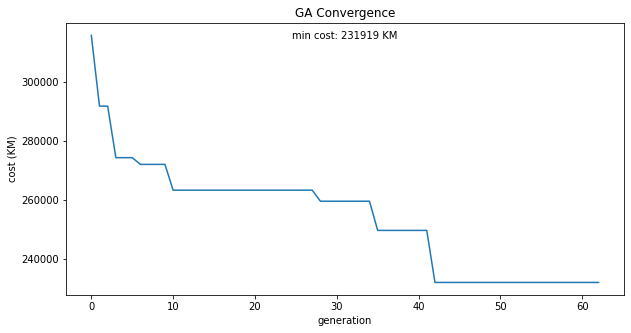

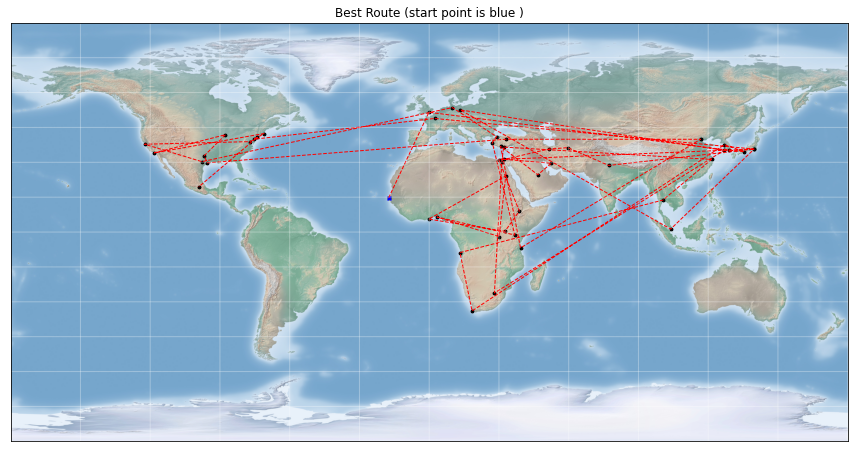

In [43]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.5
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,mut_rate = 0.5 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.5,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 0.75

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 28 generations in 4.338649 s
-- TSP-GA -- Minimum travelling cost 254820 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . Tokyo
2 . Osaka
3 . Austin
4 . Mexico City
5 . Seoul
6 . Boston
7 . Houston
8 . Chicago
9 . San Francisco
10 . Washington DC
11 . Shinjuku City
12 . Nairobi
13 . Johannesburg
14 . Aswan
15 . Addis Ababa
16 . Accra
17 . Riyadh
18 . Dakar
19 . Cairo
20 . Ankara
21 . Shiraz
22 . London
23 . Hamburg
24 . Berlin
25 . Izmir
26 . Delhi
27 . Bangkok
28 . Shanghai
29 . Philadelphia
30 . Kigali
31 . Cape Town
32 . Singapore
33 . Port Said
34 . Tehran
35 . Alanya
36 . Antalya
37 . Dar es Salaam
38 . Luanda
39 . Beijing
40 . Istanbul
41 . Mashhad
42 . Alexandria
43 . Kampala
44 . Lagos
45 . Paris
46 . New York
47 . Los Angeles
48 . Dallas
49 . Gwangju
50 . Busan


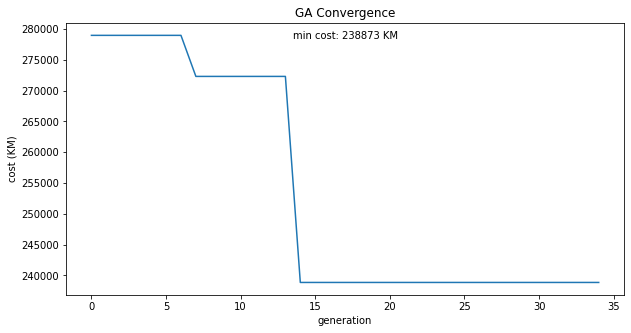

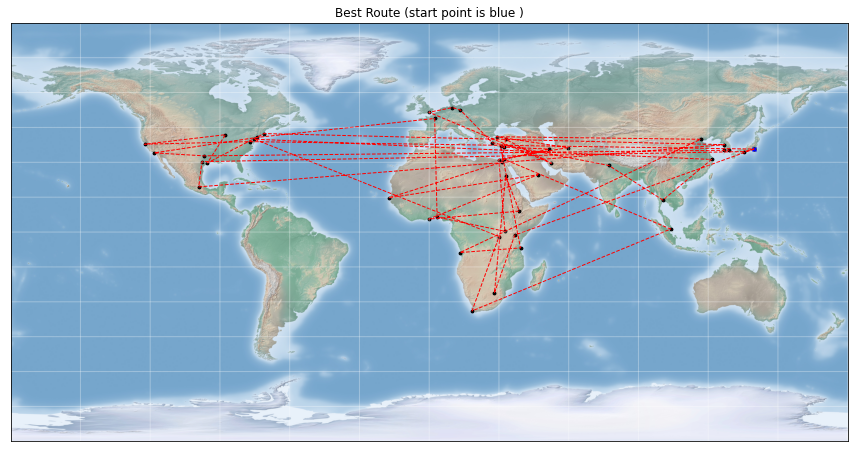

In [44]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 0.75
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,mut_rate = 0.75 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 0.75,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])

## mut_rate = 1.0

-- Running TSP-GA with 50 cities --
-- TSP-GA -- Initiating evolution...
-- TSP-GA -- Evolution finished after 35 generations in 5.905042 s
-- TSP-GA -- Minimum travelling cost 288877 KM
-- Done --
-----------------
Best Path : 
-----------------
1 . London
2 . Johannesburg
3 . Cairo
4 . Boston
5 . Mexico City
6 . Houston
7 . Bangkok
8 . Addis Ababa
9 . Seoul
10 . Singapore
11 . Beijing
12 . Busan
13 . Osaka
14 . Gwangju
15 . San Francisco
16 . New York
17 . Shiraz
18 . Cape Town
19 . Dar es Salaam
20 . Paris
21 . Aswan
22 . Delhi
23 . Istanbul
24 . Alanya
25 . Washington DC
26 . Chicago
27 . Dallas
28 . Austin
29 . Philadelphia
30 . Shinjuku City
31 . Nairobi
32 . Kigali
33 . Hamburg
34 . Dakar
35 . Lagos
36 . Kampala
37 . Luanda
38 . Port Said
39 . Riyadh
40 . Tehran
41 . Los Angeles
42 . Mashhad
43 . Accra
44 . Alexandria
45 . Shanghai
46 . Tokyo
47 . Ankara
48 . Berlin
49 . Antalya
50 . Izmir


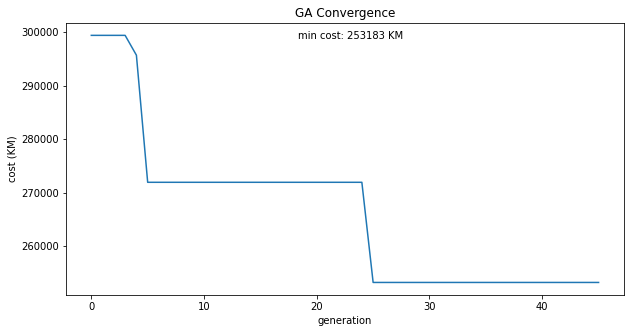

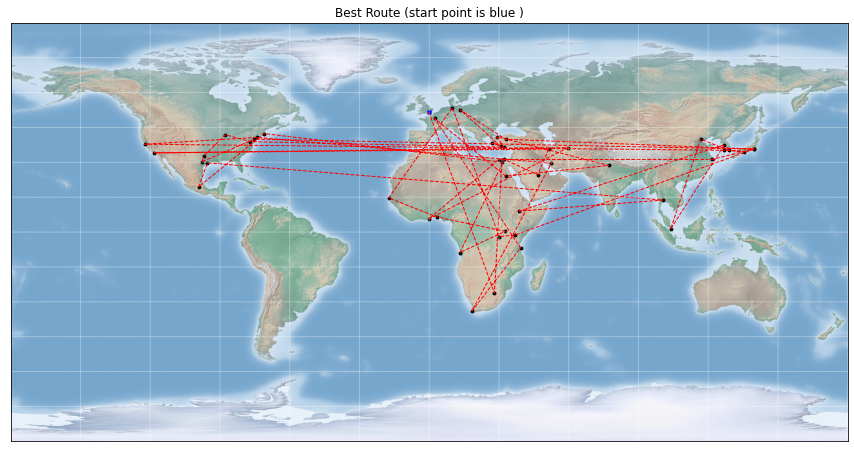

In [45]:
'''
-------------------
defult parameters :
-------------------
verbose = 1
pop_size = 500 
tourn_size = 50 
mut_rate = 0.02 - > 1.0
n_gen = 20

run_number = 50
'''

run_number = 50 

best_history =  run(verbose = 1 ,mut_rate = 1.0 , dataset = dataset)
best_score = best_history['cost'][-1]
for i in range(run_number):
  history = run(verbose = 0 ,mut_rate = 1.0,dataset = dataset)
  if history['cost'][-1] < best_score:
      best_score = history['cost'][-1]
      best_history = history

show_best_path(best_history['route'])
plot_ga_convergence(best_history['cost'])
plot_route( best_history['route'])